# Computer Vision - Assignment 3 - Feature Extraction and Image Stitching

#### 10 points   |   Due date: April 14, 23:59   |   Submission site: https://pradoposgrado2324.ugr.es/

### Student's Full Name: **Anna Ivanchenko**



In this assignment you will learn:

a) to detect interest points using the Harris Corner Detector (Exercise 2) and a multi-scale approach to detect blobs using the Laplacian of Gaussian (Exercise 1).

b) to find correspondences between the keypoints from two images using descriptors (SIFT and Haralick) (Exercise 3).

c) to compose a rectangular mosaic/panorama from a bunch of images using homographies (Exercise 4).

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)
import sys,os
%cd '/content/drive/My Drive'
get_image = lambda route: os.path.join('/content/drive/MyDrive/images/', route)
import numpy as np
from matplotlib import pyplot as plt
import cv2

Mounted at /content/drive
/content/drive/My Drive


In [ ]:
'''
This function receives a string with the filename of the image to read,
and a flag indicating if we want to read it in color/RGB (flagColor=1) or gray level (flagColor=0)

Example of use:
im1=readIm(get_image('apple.jpg'),0)

'''
def readIm(filename, flagColor=1):
  # cv2 reads BGR format
  im=cv2.imread(filename)
  # change to  RGB and return the image
  if(flagColor):
    return cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
  # change from BGR to grayscale instead if flag is 0
  return cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)

In [ ]:
'''
This function receives an array of arbitrary real numbers (that could include even negative values),
and returns an 'image' in the range [0,1].
flag_GLOBAL allows the user to normalize the whole image (including all channels) or to normalize
each channel/band independently.
'''
def rangeDisplay01(im, flag_GLOBAL= True):
  im = im.astype(float)
  if flag_GLOBAL:
    im = (im - im.min())/(im.max() - im.min())
  else:
    # bands normalization
    for band in range(im.shape[2]):
      im[:, :, band] = (im[:, :, band] - im[:, :, band].min())/(im[:, :, band].max() - im[:, :, band].min())
      # Note: remember that, for plt.imshow with RGB data, the valid range is [0..1] for floats and [0..255] for integers.
  return im

In [ ]:
'''
This function displays a single image, including a title, using a magnification factor.

Example of use:
im1=readIm(get_image('apple.jpg'),0)
displayIm(im1,'Manzana',0.5)

'''
def displayIm(im, title='Result',factor= 2):
  # First normalize range
  max=np.max(im)
  min=np.min(im)
  if min<0 or max>255:
    im=rangeDisplay01(im,flag_GLOBAL=True)
  if len(im.shape) == 3:
    # im es tribanda
    plt.imshow(im, cmap='jet')
  else:
    # im es monobanda
    plt.imshow(im, cmap='gray')
  figure_size = plt.gcf().get_size_inches()
  plt.gcf().set_size_inches(factor * figure_size)
  plt.title(title)
  plt.xticks([]), plt.yticks([]) # eliminamos numeración
  plt.show()

In [ ]:
'''
This function displays multiple images (including a title and using a magnification factor)
of equal size. The input to the function is a list of images.

Example of use:
im1=readIm(get_image('apple.jpg'),1)
images = [im1,im1,im1]

displayMI_ES(images, title='Manzanas',factor=1)

'''
def displayMI_ES(vim, title='Result',factor=2):
  # We set the maximun number of images to concatenate by columns
  maxcolumns=3
  # number of images to display
  numberim=len(vim)
  # The simplest case, one row: the maximum number of columns is larger than the images to stack
  # This is, by default, we put together the images column-wise
  if len(vim) < maxcolumns:
    out=vim[0]
    for item in range(1,len(vim)):
      #displayIm(out,str(item),1)
      out=np.hstack((out,vim[item]))

  # Else, if maxcolumns is smaller or equal than the number of images to stack
  else:
    # We check if all rows and columns are going to be 'busy', or if otherwise we need an extra-row
    if np.mod(len(vim),maxcolumns)== 0:
      maxrows=numberim//maxcolumns
    else:
      maxrows=numberim//maxcolumns+1

    # we build up the first block-row
    out=vim[0]
    for item in range(1,maxcolumns):
      out=np.hstack((out,vim[item]))
    # We build up the rest of block-rows
    for block in range(1,maxrows):
      #print(block)
      row=vim[block*maxcolumns]
      for item in range(1,maxcolumns):
        # We still have images to stack
        if block*maxcolumns+item < numberim:
          row=np.hstack((row,vim[block*maxcolumns+item]))
        # We do not have more images, and we have to fill with black
        else:
          row=np.hstack((row,np.zeros(vim[0].shape,dtype=vim[0].dtype)))
          #print(row.dtype)
          # if we don't include ',dtype=vim[0].dtype', np.zeros will include float
          # numbers in the matrix. This will make that the whole matrix will be
          # considered as floats, and values larger than 1 will be clipped to 1,
          # displaying an almost totally white image
      # add the new block-row
      out=np.vstack((out,row))
  return displayIm(out,title,factor)

In [ ]:
# Here you include your functions from P1 to compute derivatives and convolution

'''
This function calculates the discrete 1D masks of the Gaussian function,
its 1st and 2nd derivatives
'''
def GaussFunc(x,sigma):
    return np.exp(-(x**2/(2*sigma**2))) # I computed 1D  Gaussian function, but ignored constant c

def GaussDeriv1Func(x,sigma):
    return (-x/(sigma**2))*GaussFunc(x, sigma) # Computed First Derivative of 1D Gaussian function from previous step

def GaussDeriv2Func(x,sigma):
    return ((x**2-sigma**2)/(sigma**4))*GaussFunc(x, sigma) # Computed Second Derivative of 1D Gaussian function (took one more derivative from the first derivative)

def gaussianMask1D(sigma=0, sizeMask=0, order=0): # Function to compute Gaussian Mask, 1st and 2nd derivative
    if sizeMask==0: # Calculate sizeMask for the case when sigma is provided
        sizeMask = int(2*(3*sigma)+1) # (T-1)/2=3*sigma -> T=2*(3*sigma)+1, where T is a sizeMask
    elif sigma==0: # Calculate sigma for the case when sizeMask is provided
        sigma = (sizeMask-1)/6 # As (T-1)/2=3*sigma from the slide 23

    # Created a 1D mask centered at 0.
    # min(k) >= 3*sigma -> k = 3*sigma: k is varies from -3*sigma to 3*sigma
    k = np.floor(3*sigma)
    x = np.arange(-k, k+1) # added +1, as the the second border is not included in this function: numpy.arange([start, ]stop, [step, ]dtype=None, *, like=None)

    # Calculate Guassian mask, 1st and 2nd deriv depend on the order
    if order==0:
        mask=GaussFunc(x, sigma)  # Calculated Gaussian mask with previously created function
        # Normalized mask: Gaussian kernel is smoothing, so we need to divide by the sum
        mask /= np.sum(mask)
    elif order==1:
        mask=GaussDeriv1Func(x, sigma)  # Calculated first derivative mask with previously created function
        # Normalized mask: 1st Derivative kernel is Differentiating, so we need to multuply by sigma (this way we recover the amplitude)
        mask = mask*sigma
    elif order==2:
        mask=GaussDeriv2Func(x, sigma)  # Calculated second derivative mask with previously created function
        # Normalized mask: 2nd Derivative kernel is Differentiating, so we need to multuply by sigma**2 (in order to recover the response and avoid shrinking)
        mask = mask*sigma**2

    return mask, x

'''
This function performs 2D convolution on an image with Gaussian and derivative masks.
'''
def my2DConv(im, sigma, orders):
    ddepth=cv2.CV_64F # For visualization purposes
    maskG,_=gaussianMask1D(sigma, order=0) # Calculate 1D Gaussian mask
    maskDG,_=gaussianMask1D(sigma, order=1) # Calculate 1st order derivative
    mask2DG,_= gaussianMask1D(sigma, order=2) # Calculate 2nd order derivative
    if orders==[0,0]: # Gaussian smoothing
      # Smooth in both directions
      return cv2.sepFilter2D(im,ddepth,maskG,maskG)
    elif orders==[1,0]: # First derivative in X
      # Smooth in Y direction, differentiate in X direction
      return cv2.sepFilter2D(im,ddepth,maskDG,maskG)
      # and MaskG as vertical 1D Gaussian kernel.
    elif orders==[0,1]: # First derivative in Y
      # Smooth in X direction, differentiate in Y direction
      return cv2.sepFilter2D(im, ddepth, maskG, maskDG)
    elif orders == [2, 0]: # Second derivative in X
      # Smooth in Y direction, differentiate twice in X direction
      return cv2.sepFilter2D(im, ddepth, mask2DG, maskG)
    elif orders == [0, 2]: # Second derivative in Y
      # Smooth in X direction, differentiate twice in Y direction
      return cv2.sepFilter2D(im, ddepth, maskG, mask2DG)
    else:
      print('error in order of derivative')

'''
# Gradients, magnitude and orientation
Gx = my2DConv(im, sigma, [1, 0]) # First derivative in X direction
Gy = my2DConv(im, sigma, [0, 1]) # First derivative in Y direction
Gmag = rangeDisplay01(np.sqrt(Gx**2 + Gy**2),True) # The magnitude of the gradient
Gdir = rangeDisplay01(np.arctan2(Gy, Gx),True) # The orientation of the gradient
# Laplacian of Gaussian
LoG = rangeDisplay01(my2DConv(im, sigma, [2, 0]) + my2DConv(im, 3.0, [0, 2])) # Calculated as the sum of second derivative in X and Y direction after Gaussian smoothing
'''

'\n# Gradients, magnitude and orientation\nGx = my2DConv(im, sigma, [1, 0]) # First derivative in X direction\nGy = my2DConv(im, sigma, [0, 1]) # First derivative in Y direction\nGmag = rangeDisplay01(np.sqrt(Gx**2 + Gy**2),True) # The magnitude of the gradient\nGdir = rangeDisplay01(np.arctan2(Gy, Gx),True) # The orientation of the gradient\n# Laplacian of Gaussian\nLoG = rangeDisplay01(my2DConv(im, sigma, [2, 0]) + my2DConv(im, 3.0, [0, 2])) # Calculated as the sum of second derivative in X and Y direction after Gaussian smoothing\n'

# **Exercise 1:** Multi-scale blob detection using the Laplacian of Gaussian (2 points)

Students must implement a multiscale blob detector in Python that, based on successive applications of Laplacian of Gaussian (LoG) filters, allows them to identify interest points/regions. The process to follow is detailed below:

> 1) use the following sigmas to create the corresponding scales: 11 values starting from $\sigma_0 = 0.5$ and increase $\sigma$ by a factor of 1.5. In other words, $\sigma=[0.5, 0.75, 1.125, 1.687, 2.531, 3.796, 5.695, 8.542, 12.814, 19.221, 28.832]$. Remember to convolve the image with scale-normalized LoG.

> 2) Find maxima of squared Laplacian response in scale-space. Select the local maximum corresponding to a neighborhood $3\times3\times3$, where the central pixel of this volume would be the position to evaluate. That is, each pixel is compared with its 26 neighbors and saved if it is a maximum. The function `maximum_filter` from `scipy.ndimage` may be useful here. Along with this, also use a $\textit{threshold}$ to limit the number of blobs detected to around 1000 points.

> 3) Draw the detected blobs as circles centered on the identified Cartesian coordinates, and radius proportional to the scale at which the corresponding blob was detected.

The process is visually shown on slide 63 of https://pradogrado2324.ugr.es/pluginfile.php/234073/mod_folder/content/0/3.3.BoW_Blobs.pdf

**Solution:**

In this section, I perform steps for blob detection using the `my2DConv` function for Laplacian of Gaussian (LoG) calculation, the `maximum_filter` function from `scipy.ndimage` to find maxima of squared Laplacian response in scale-space and threshold to limit the number of blobs detected.

### **Step 1: Scale-normalized LoG Convolution**

**1. Defining Scale Parameters:**

A list of `sigmas` is defined to control the scale at which blobs are detected. These scales correspond to the standard deviations of the Gaussian component of the Laplacian of Gaussian filter. Each sigma value corresponds to a different blob size, allowing detection across a range of sizes.

**2. Blob Detection via LoG Filter:**

For each `sigma`, the script computes a scale-normalized LoG filter response. The LoG filter is a blob detector that highlights areas in the image where the change in intensity resembles a blob-like structure at the scale defined by `sigma`. Scale normalization (multiplication by sigma squared) ensures that the response is comparable across different scales.

**3. Convolution and Response Calculation:**

The image is convolved with the LoG filter using a custom convolution function `my2DConv`. The sum of the second derivatives in both the x and y directions are taken, effectively applying the Laplacian operation. The square of the result is taken to enhance the visibility of the response and focus on regions with strong blob characteristics.

**4. Displaying the Results:**

Finally, the script displays the filtered images for each sigma.

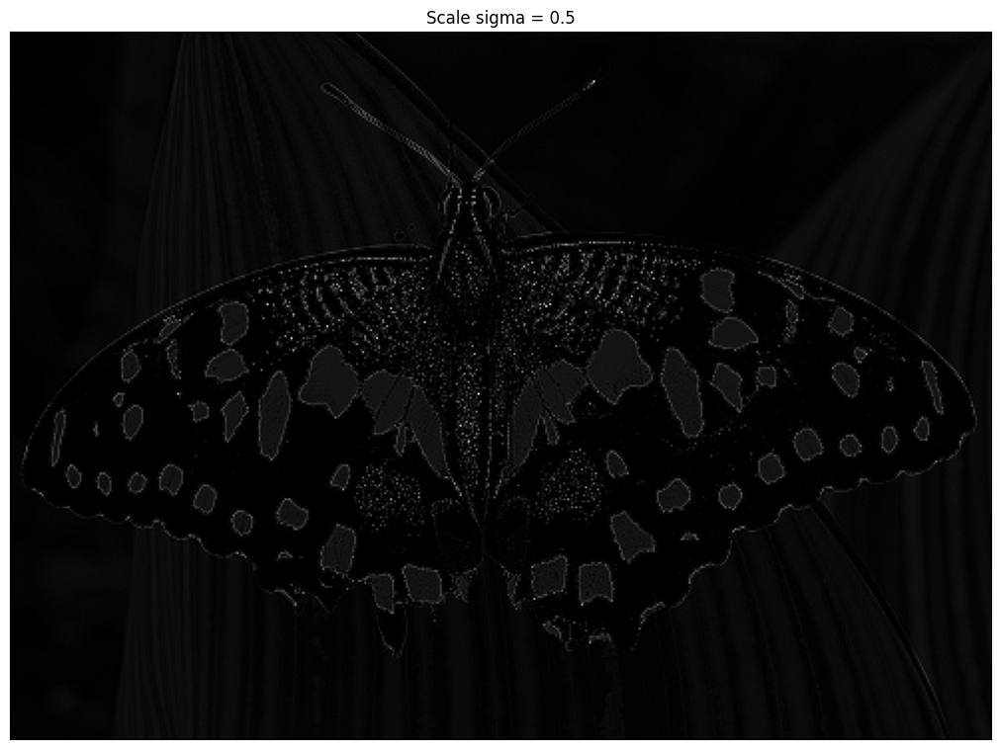

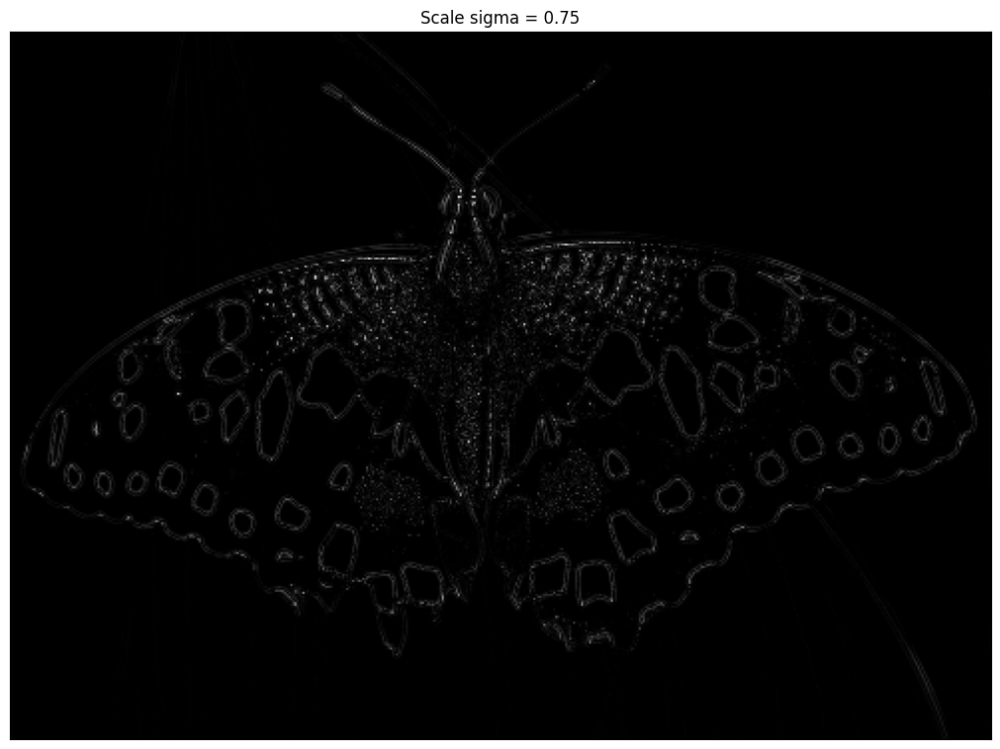

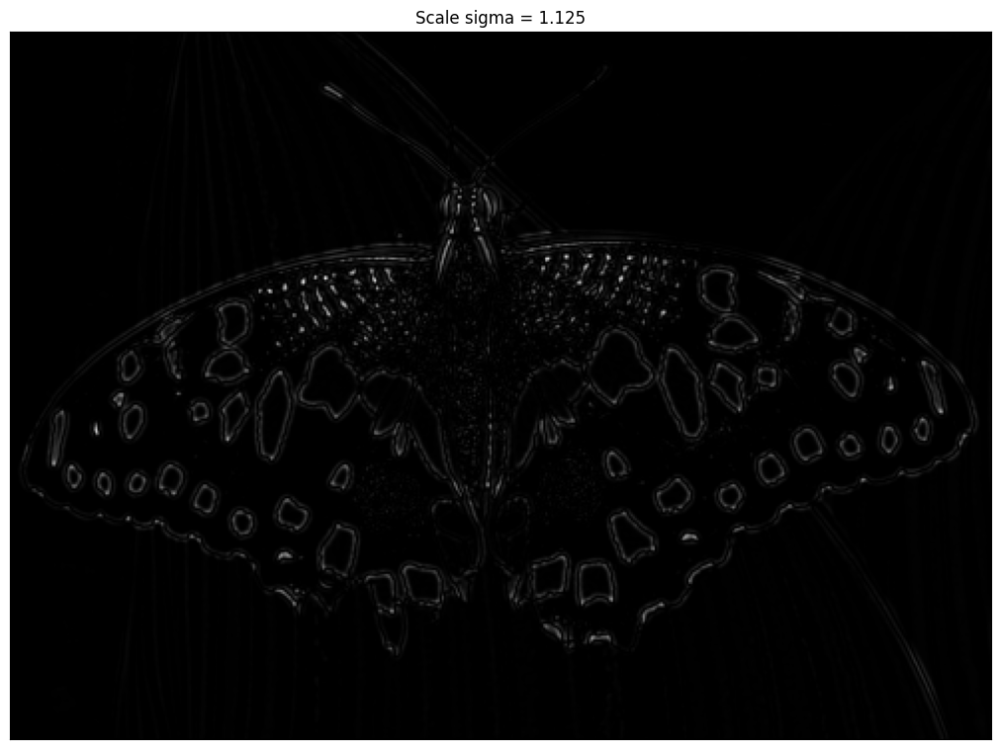

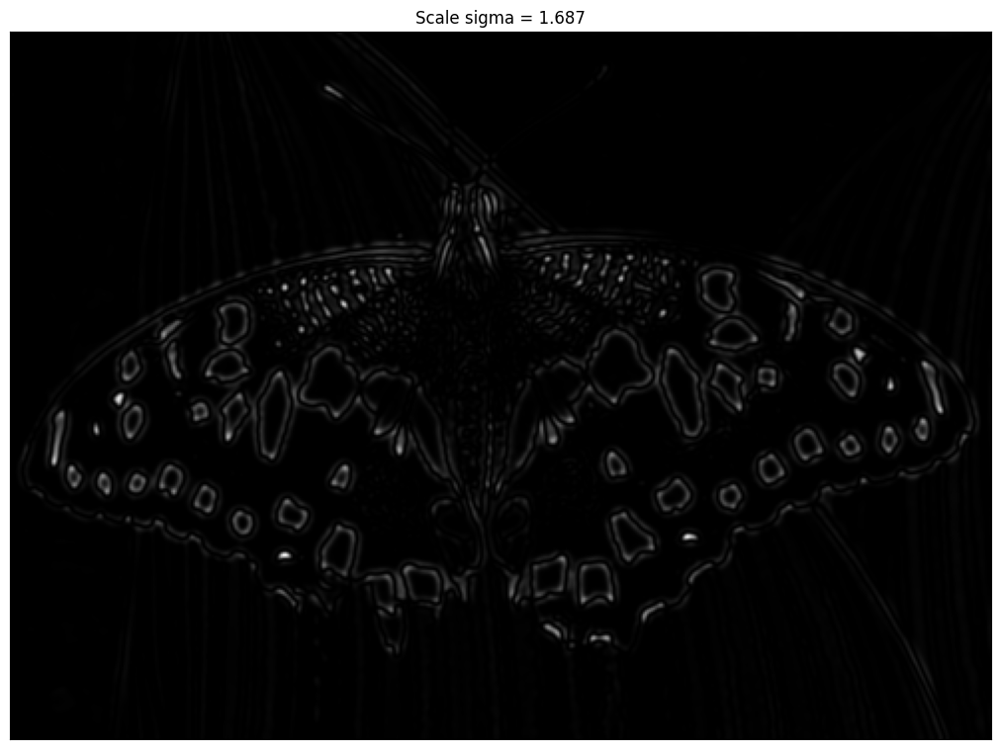

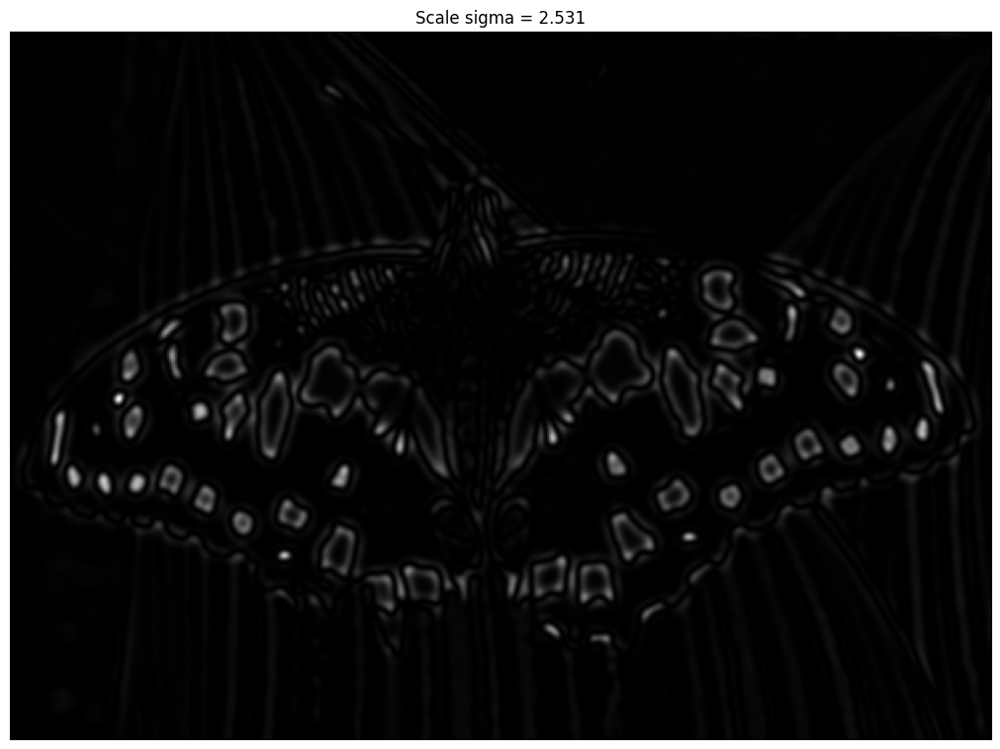

...

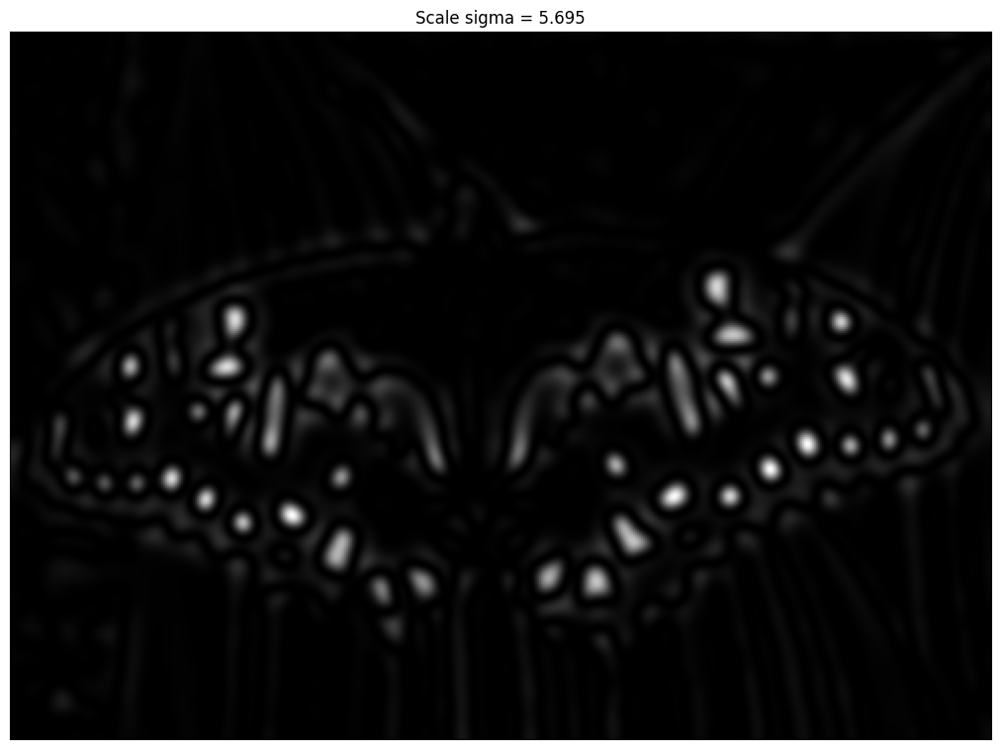

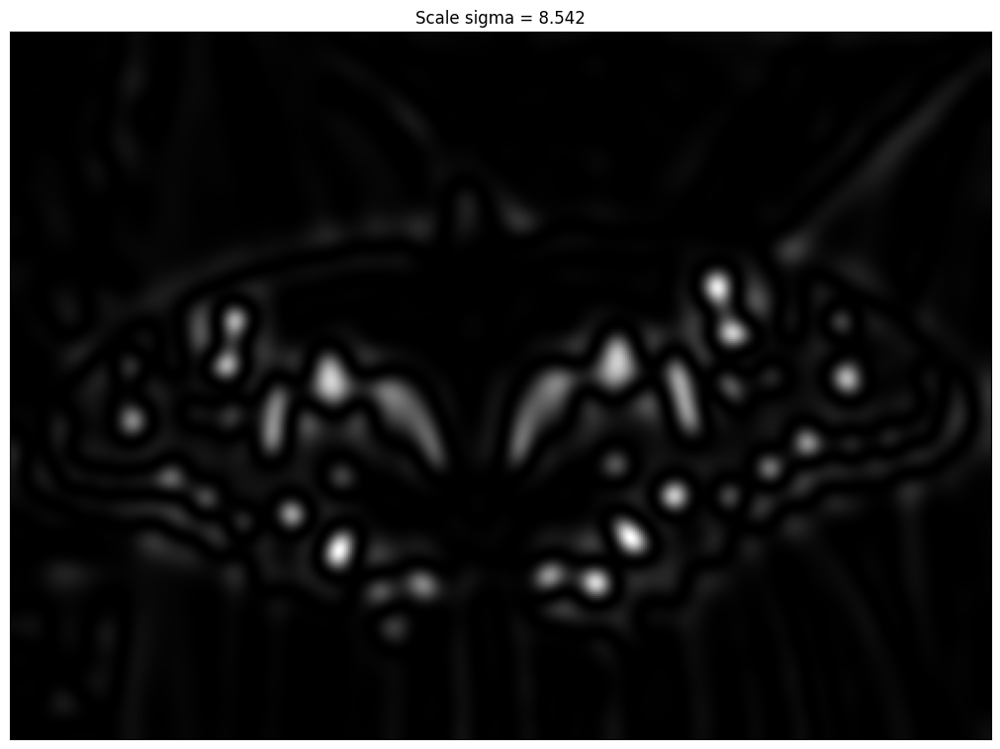

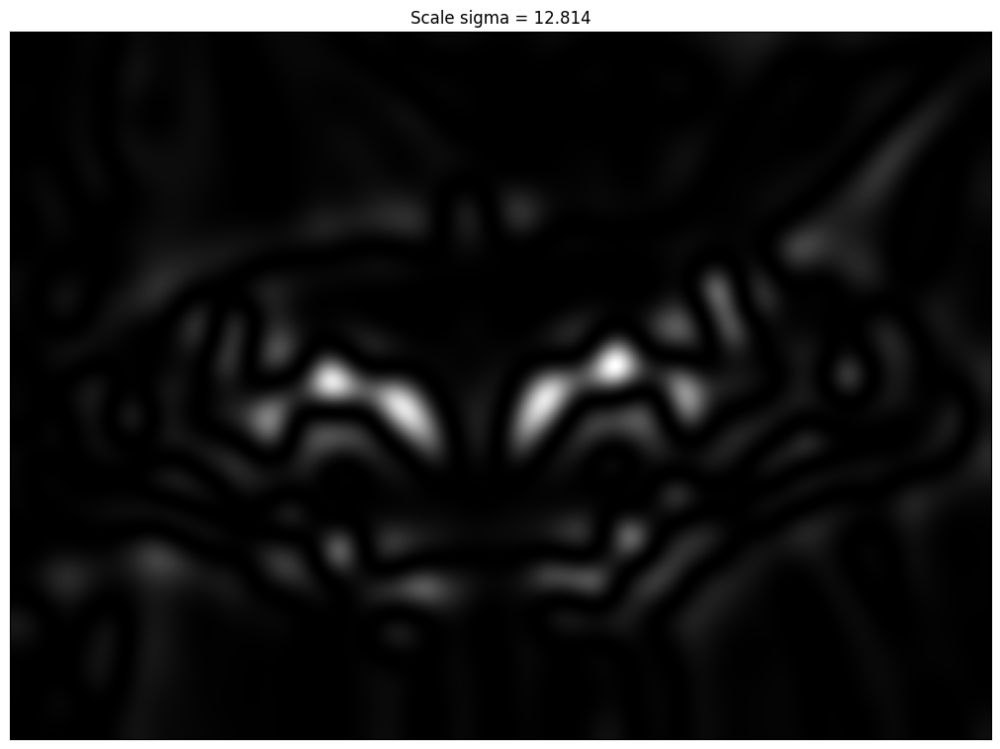

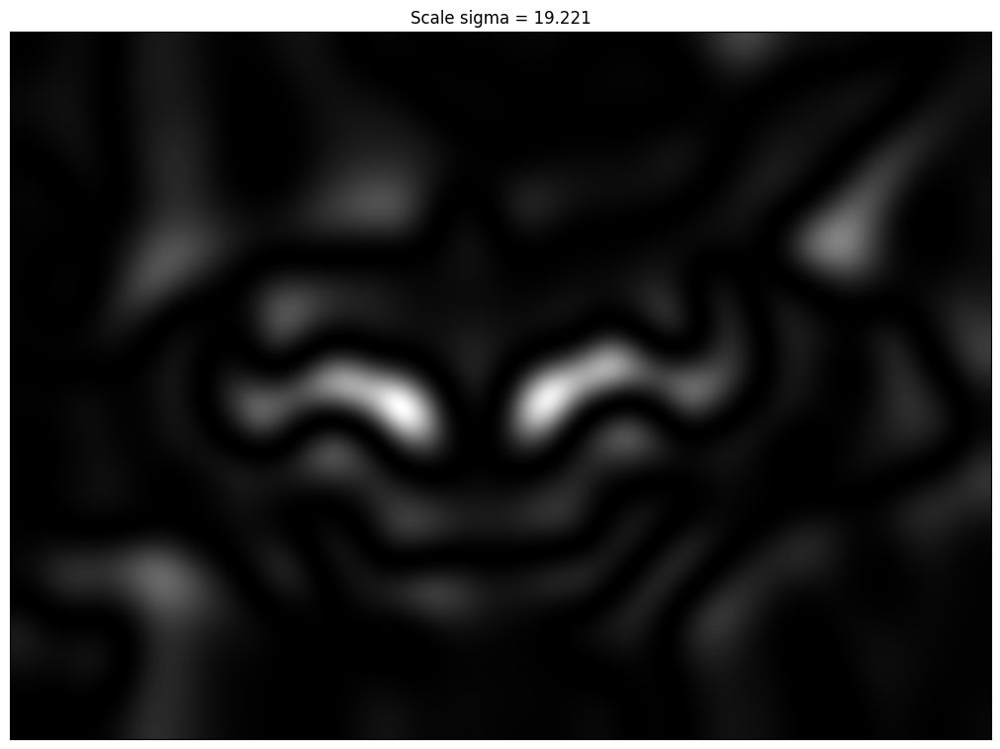

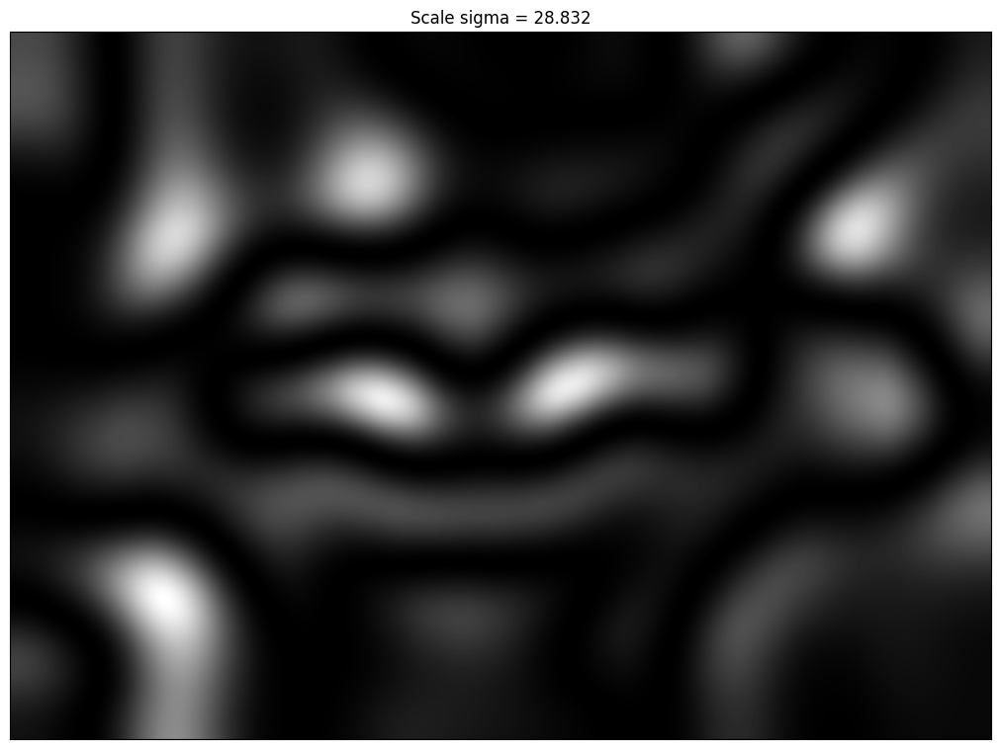

In [ ]:
im=readIm(get_image('butterfly.jpg'),0) # Read an image from a file 'butterfly.jpg' and convert it to grayscale

# To compute Blob Detection we can convolve the image with a “blob filter” at multiple scales
# and look for extrema of filter response in the resulting scale space.

# Step 1:
# Define sigmas to create the corresponding scales
sigmas = [0.5, 0.75, 1.125, 1.687, 2.531, 3.796, 5.695, 8.542, 12.814, 19.221, 28.832]
# Convolve the image with scale-normalized LoG at multiple scales and look for extrema
log_response = [] # Initialize an empty list to store the responses from the Laplacian of Gaussian filter at each scale
for sigma in sigmas: # Iterate through each sigma to apply the LoG filter at multiple scales
    # Calculating scaled-normalized LoG as the sum of second derivative in X and Y direction,
    # which were scaled before, and convolving it with image by using my2DConv function from Assigment 1
    log_response.append(np.square(my2DConv(im, sigma, [2, 0]) + my2DConv(im, sigma, [0, 2])))
    # We use np.square to get squared Laplacian response
# Loop through the scale-space responses to display the results
for i in range(len(sigmas)):
    # Displaying results of image convolved with scaled-normalized LoG
    displayIm(log_response[i], title=f"Scale sigma = {sigmas[i]}")

### **Step 2: Finding Maxima in Scale-Space**
**1. 3D Scale-Space Construction:**
The responses from different scales are stacked together to form a three-dimensional array. This allows for comparison across scales as well as spatial dimensions to accurately identify blobs that persist over multiple scales.

**2. Maximum Filtering:**

The `maximum_filter` is used to isolate local maxima within a 3x3x3 neighborhood across the scale-space. This filter helps to ensure that only the strongest responses, indicative of significant blob-like structures, are considered in following steps.

**3. Identification of Maxima:**

A comparison is made between the original scaled responses and the filtered output to pinpoint where the local maxima occur. This ensures that only points which are the highest within their immediate spatial and scale neighborhood are marked as potential blobs.

**4. Thresholding for Blob Selection:**

To manage the number of detected blobs and focus on the most prominent ones, a threshold is applied based on the intensity of the responses. By using the 95th percentile, the script effectively filters out all but the strongest 5% of the responses, aligning with the target of detecting approximately 1000 blobs.

**5. Blob Position Extraction and Visualization:**

The positions of blobs are extracted and visualized on the original image. For each blob, a circle is drawn with a radius proportional to the scale at which the blob was detected, illustrating the blob's size and location.

Detected 889 blobs.


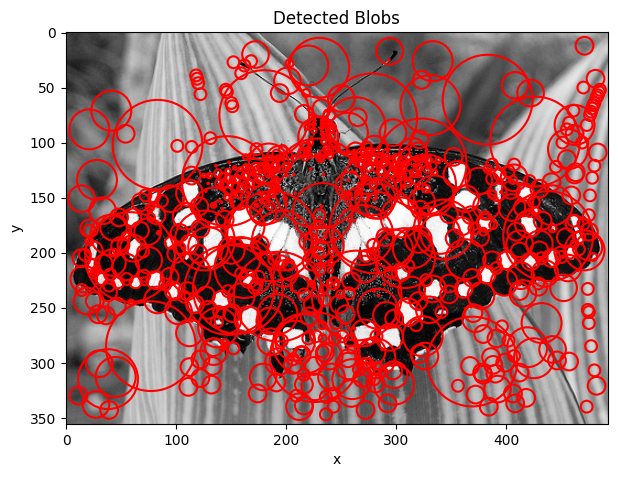

In [ ]:
from scipy.ndimage import maximum_filter
import matplotlib.patches as patches

# Step 2: Blob Detection in Scale-Space
# This part of the script finds local maxima in the scale-space created from the Laplacian responses
# These maxima represent potential blobs in the image

# Stack the Laplacian responses to create a 3D scale-space image, where each 'slice' corresponds to a scale
scaled = np.stack(log_response, axis=0)
# Apply a maximum filter to find local maxima within a 3x3x3 neighborhood in the scale-space
# This step enhances peaks and suppresses all other values that are not local maxima
filtered = maximum_filter(scaled, size=(3, 3, 3))
# Create a boolean array that is True at positions where the scale-space equals the maximum filter response
# These positions are the local maxima in the 3D scale-space
maxima = (scaled == filtered)
# Determine a threshold to eliminate weaker responses and reduce the number of detected blobs
# The 95th percentile is used here to keep only the top 5% strongest responses, aiming for about 1000 blobs
threshold = np.percentile(scaled[maxima], 95)
# Apply the threshold to filter out weaker maxima, resulting in the final set of detected blobs
maxima_thresholded = maxima & (scaled > threshold)
# Extract the positions of these maxima, which correspond to the locations of blobs in the image
positions = np.argwhere(maxima_thresholded)
# Print the number of blobs detected
print(f"Detected {len(positions)} blobs.")

# Visualize the blobs
plt.figure(figsize=(7, 7))
plt.imshow(im, cmap='gray')  # Use cmap='gray' because the image is grayscale
plt.title('Detected Blobs')
plt.xlabel('x')
plt.ylabel('y')

# For each detected blob, draw a circle at the corresponding position and scale
for pos in positions:
  scale_idx = pos[0] # Index of the scale in 'sigmas'
  y, x = pos[1:] # Spatial coordinates of the blob in the image
  sigma = sigmas[scale_idx] # Sigma corresponding to the blob's scale
  radius = sigma * np.sqrt(2) # Convert sigma to radius for visualization purposes
  # Skip blobs that are too close to the image boundaries
  if (x - radius < 0 or x + radius > im.shape[1] - 1 or
    y - radius < 0 or y + radius > im.shape[0] - 1): continue
  # Draw a circle around each blob
  circle = patches.Circle((x, y), radius, fill=False, edgecolor='red', linewidth=1.5)
  plt.gca().add_patch(circle)
# Display the resulting image with blobs highlighted
plt.show()

# **Exercise 2:** Harris Corner Detector (3 points)

Write the Python code necessary to implement the detection of the stronger 100-150 Harris points in an image. The steps to implement the Harris corner detector are the following: \


> a) Set the derivative ($\sigma_D$) and integration scales ($\sigma_I$) to 1.5 and 2.25, respectively. Other sigma values can also be employed if the student considers that it improves performance.



> b) Compute the image derivatives.

> c) Compute the three terms of the second moment matrix ($SMM$) at each pixel. To do it, apply convolution with a Gaussian mask with $\sigma_I$.

> d) Compute the Harris value at each pixel of the image.

> e) Apply Non-Maxima Suppression by using the function `corner_peaks()` (https://scikit-image.org/docs/stable/api/skimage.feature.html#skimage.feature.corner_peaks) from the module `skimage.features`. The student must select a suitable `min_distance` (`minimal allowed distance separating peaks`), and a suitable response threshold in the Harris Map to just keep the number of keypoints we need (100-150). The output will be a list of $(x,y)$ coordinates. Extract the values in these coordinates and create a list of vectors $(x,y,value)$.

> f) Compute the main orientation for each point. This is done by smoothing both derivative images with a sufficiently large sigma ($\sigma=3$) and computing the orientation of the gradient at those points.

> d) Create a list of KeyPoints using the selected points. A KeyPoint is a vector including $(x,y,scale,orientation)$. A KeyPoint is an OpenCV's structure (`cv2.KeyPoint`), associated to each detected region,  necessary to call OpenCV feature extractor algorithms.

> e) Draw the keypoints on the image using the function `drawKeyPoints()` (https://docs.opencv.org/4.x/d4/d5d/group__features2d__draw.html#ga5d2bafe8c1c45289bc3403a40fb88920), and flags `cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG+cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS`.


**Solution:**

In this section, I will describe steps performed for the Harris Corner Detector creation.

### **Step 1: Derivative Computation**

The derivatives function calculates the first derivatives of the image using `my2DConv` function. The image is first converted to a `float32` type for precision during calculations. Gaussian smoothing is used to reduce noise and compute derivatives more accurately. `sigmaD` controls the scale of the Gaussian derivative filters, influencing the smoothness of the derivative computation.

### **Step 2: Harris Map Calculation**

The HarrisMap function calculates the Harris corner response based on the derivatives. The products of the derivatives `Ixx, Ixy, Iyy` form the components of the second moment matrix at each pixel. These components are then smoothed with a Gaussian filter of width `sigmaI`, which controls the window over which corners are detected.

The determinant `detH` and trace `traceH` of the smoothed second moment matrix are computed. The determinant represents the product of the eigenvalues and is a measure of the corner strength, while the trace is the sum of the eigenvalues and is a measure of the overall intensity change. The Harris corner response `HMap` is calculated using the formula detH / traceH, which is designed to be high for regions with significant changes in multiple directions `corners` and low in flat or edge regions.

In [ ]:
'''
Function to compute the first derivatives of the image with respect to x and y using a Gaussian filter
'''
def derivatives(im, sigmaD):
  im = im.astype(np.float32)  # Ensure the image is in float32 for precision during derivatives
  # Convolve image with a derivative filter in the X direction to compute dx
  dx = my2DConv(im, sigmaD, [1, 0])
  # Convolve image with a derivative filter in the Y direction to compute dy
  dy = my2DConv(im, sigmaD, [0, 1])
  return dx, dy

'''
Function to compute the Harris corner response map using the derivatives of the image
'''
def HarrisMap(dx, dy, sigmaI):
  # Calculate the products of derivatives necessary for the Harris response
  Ixx = dx**2  # Square of the derivative in X
  Ixy = dx*dy  # Product of the derivative in X and Y
  Iyy = dy**2  # Square of the derivative in Y
  # Apply Gaussian smoothing to the second moment matrix components
  Sxx = my2DConv(Ixx, sigmaI, [0, 0])  # Smoothed second moment matrix component in X
  Sxy = my2DConv(Ixy, sigmaI, [0, 0])  # Smoothed mixed second moment matrix component
  Syy = my2DConv(Iyy, sigmaI, [0, 0])  # Smoothed second moment matrix component in Y
  # Compute the determinant and trace of the smoothed second moment matrix
  detH = Sxx * Syy - Sxy**2  # Determinant of the second moment matrix
  traceH = Sxx + Syy  # Trace of the second moment matrix
  # Compute the Harris corner response map
  HMap = detH / traceH  # Harris corner response: det(H) / trace(H)
  return HMap

### **Step 3: Non-Maximum Supresssion**

**Corner Detection via Non-Maximum Suppression:**

The NonMaximaSuppression function aims to identify the most significant corner points within the Harris response map. It utilizes the `corner_peaks` function from `skimage.feature`, which performs non-maximum suppression to find local maxima of the Harris response. This process ensures that the corners identified are true corners and not part of a noisy or less distinct edge.

**Parameters:**

- `min_distance`: Specifies the minimum Euclidean distance between the corners detected. It ensures that the detected corners are not clustered too closely, which helps in identifying distinct corner points.
- `threshold_rel`: This relative threshold parameter sets a baseline intensity level for a corner to be considered significant. Only corners with a Harris response greater than this threshold, relative to the strongest response in the map, are returned. This helps to filter out weaker corners and reduces false positives.

**Output:**

After identifying potential corner points, the function extracts their coordinates and corresponding Harris response values. These values indicate the strength of each corner.

In [ ]:
'''
Function to perform non-maximum suppression on the Harris response map to identify and refine corner points.
'''
def NonMaximaSuppression(harrisMap, min_distance, threshold):
    # Find corners in the Harris response map with `corner_peaks` function:
    # This function applies a non-maximum suppression to find peaks in the map
    # `min_distance` is the minimum number of pixels separating peaks in the resulting corners
    # `threshold_rel` is the relative threshold of the intensity of peaks
    # It defines the minimum intensity a corner must have relative to the highest corner intensity in the image
    points = corner_peaks(harrisMap, min_distance=min_distance, threshold_rel=threshold)
    # Convert points list to a numpy array for further manipulation and easier indexing
    coord = np.array(points)
    # Extract the Harris response values at the detected corner locations
    # This involves indexing the `harrisMap` with the coordinates of the detected points
    values = harrisMap[points[:, 0], points[:, 1]]
    # Return the coordinates of the corners and their corresponding Harris response values
    return coord, values

### **Step 4: Orientation Calculation**

The `orientation` function calculates the orientation of the image gradient. The gradients are first smoothed using Gaussian filtering controlled by `sigma` to reduce noise and provide more stable angle calculations. The angle between the gradient vector and the x-axis is calculated using the `arctan2` function, which is robust to all quadrants of the circle. This orientation is useful for rotation invariance in detection.

### **Step 5: Keypoint Construction**

The `keyPoints` function constructs `KeyPoint` objects using the `OpenCV` library. Each keypoint holds the position `(x, y)`, the scale `size`, which can indicate the size of the region around the keypoint, and the orientation `angle`, which provides rotational information. This makes keypoints very useful for matching different views of an object or scene.

In [ ]:
'''
Function to compute the orientation map of image gradients
'''
def orientation(dx, dy):
  # Set the sigma value for Gaussian smoothing
  sigma = 3.0
  # Apply Gaussian smoothing to the gradients (this helps in stabilizing the orientation computation
  # by averaging out the gradients in a local neighborhood)
  dx_smoothed = my2DConv(dx, sigma, [0, 0])
  dy_smoothed = my2DConv(dy, sigma, [0, 0])
  # Compute the orientation of each pixel in degrees
  # The function `np.arctan2` computes the angle between the positive x-axis
  # and the point given by the coordinates (dx_smoothed, dy_smoothed)
  # The result is converted from radians to degrees
  theta = 180 * np.arctan2(dy_smoothed, dx_smoothed) / np.pi
  return theta

'''
Function to create keypoints from coordinates, orientation angles, and sizes.
'''
def keyPoints(coord, theta, size):
  keyPoints = []  # Initialize an empty list to store keypoints
  # Iterate over each coordinate and its corresponding index to create keypoints
  for i, (y, x) in enumerate(coord):
    # Retrieve the orientation angle for the current coordinate from the orientation map
    angle = theta[y, x]
    # Create a KeyPoint object. This object stores the x and y coordinates, the scale (size),
    # and the orientation (angle) of the keypoint
    keyPoints.append(cv2.KeyPoint(float(x), float(y), size=size, angle=angle, response=1))
  return keyPoints

In this section, I used previously developed functions to perform full Harris Corner Detection cycle.

**1. Image Reading and Parameter Initialization:**

We load the image of Yosemite and then processed to detect Harris corners. The parameters for the Harris detector `sigma values, minimum distance, threshold, and keypoint size` are initialized based on typical values and trial-and-error to ensure effective feature detection.

**2. Gradient Calculation:**

Derivatives of the image are computed using Gaussian filters with `derivatives` function.

**3. Harris Corner Detection:**

The Harris response is calculated from the derivatives. This involves creating the Harris matrix at each pixel and calculating its determinant and trace to determine the likelihood of each pixel being a corner.

**4. Non-Maxima Suppression:**

To ensure that the detected corners are true features and not noise, non-maxima suppression is used with `NonMaximaSuppression` function. This process refines the corner points by ensuring that each detected corner is the local maximum in its neighborhood, thereby reducing the number of potential false corners.

**5. Orientation Calculation:**

The orientation of the gradients at each corner point is computed with `orientation` function. This step is vital for rotation invariance.

**6. Keypoint Creation and Visualization:**

Keypoints are created from the refined corner coordinates, their orientations, and a predefined size. These keypoints are then visualized on the original image using OpenCV's `drawKeypoints` function, which displays each keypoint's location, scale, and orientation.

**7. Display Results:**

Finally, the image with keypoints is displayed, showing the Harris corners with their orientations and scales.

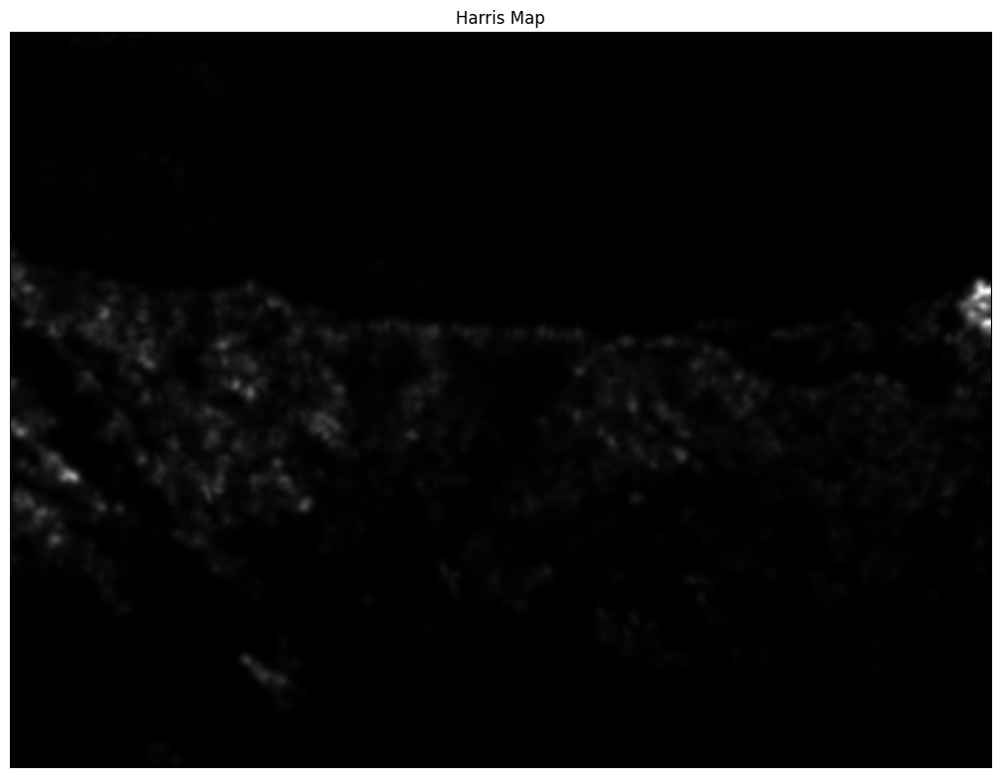

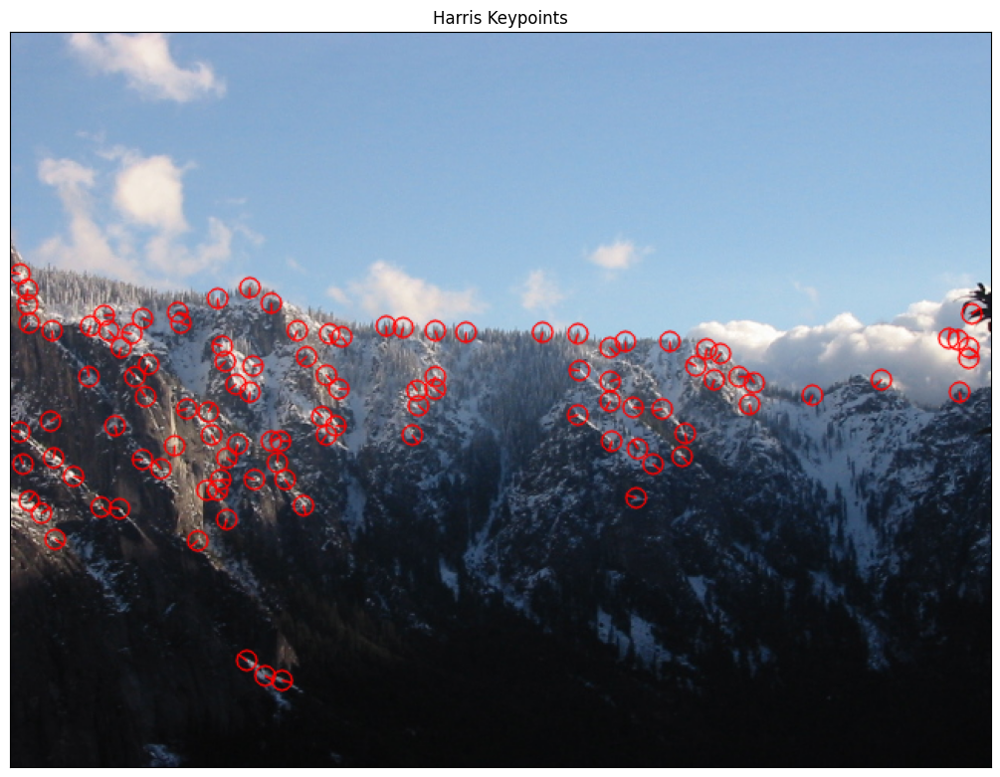

In [ ]:
# Let's compute the KeyPoints-Harris and display them
from skimage.feature import corner_peaks
img = readIm(get_image('yosemite7.jpg'), 0)

# Define parameters for Harris Corner Detection
sigmaD = 1.5 # Sigma value for derivative calculation
sigmaI = 1.5 * sigmaD # Sigma value for smoothing in Harris response calculation
min_distance = 5 # Minimum distance between corners in Non-Maxima Suppression (Emperical)
threshold = 0.1 # Relative intensity threshold for Non-Maxima Suppression (Emperical)
size = 13 # Size of the keypoint in the visual representation (Emperical)

# Compute image derivatives
dx, dy = derivatives(img, sigmaD) # Calculate first derivatives using a Gaussian derivative filter
# Compute Harris response map
HMap = HarrisMap(dx, dy, sigmaI) # Calculate the Harris response using the derivatives
displayIm(HMap, 'Harris Map') # Display Harris response Map
# Apply Non-Maxima Suppression to filter for the strongest corners
coord, values = NonMaximaSuppression(HMap, min_distance, threshold)  # Get coordinates and values of keypoints
# Compute the orientation map from the derivatives
theta = orientation(dx, dy)  # Calculate orientations of gradients
# Create a list of KeyPoints with the given coordinates, orientations, and predefined size
keypoints = keyPoints(coord, theta, size)  # Convert coordinates and orientations to OpenCV KeyPoint objects
# Draw the keypoints on the image
# read the color image to display the keypoints
img_for_keypoints = readIm(get_image('yosemite7.jpg'), 1)
# Use OpenCV's function to visualize keypoints with their sizes and orientations
img_with_keypoints = cv2.drawKeypoints(img_for_keypoints, keypoints, None, color=(255, 0, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
# Display the image with keypoints
displayIm(img_with_keypoints, title="Harris Keypoints")  # Show the resulting image with keypoints

# **Exercise 3:** Matching keypoints between images using SIFT and Haralick descriptors (2 points)

Write the Python code necessary to compute the matching between points from two images. To do so, you have to apply the SIFT algorithm to both images in order to extract keypoints and descriptors (see https://docs.opencv.org/3.4/dc/dc3/tutorial_py_matcher.html). Then, we use the Brute-Force cross-check criterion (`cv2.BFMatcher`) and Lowe's ratio distance criterion (`knnMatch`) to compute the matches and draw the best 100 matches using the function `cv2.drawMatches`.

**Solution:**

In this section I describe steps performed for marching keypoints between images using SIFR descriptor.

### **Step 1: Computing keypoints and descriptors with SIFT**

**1. SIFT Algorithm:**

The function `siftPoints` uses the SIFT algorithm, which is effective in extracting distinctive invariant features from images. These features can then be used to perform reliable matching between different views of an object or scene.

**2. SIFT Object Creation:**

A SIFT object is created with a parameter `nfeatures` that specifies the maximum number of keypoints to be detected. This allows for balancing between performance and the comprehensiveness of feature detection. The SIFT algorithm generates features that are invariant to image scale and rotation, and partially invariant to change in illumination and 3D viewpoint.

**3. Keypoint Detection and Descriptor Computation:**

The `detectAndCompute` method is a function by OpenCV that both detects keypoints and computes their descriptors simultaneously. Keypoints are locations in the image where statistically significant gradient patterns occur, and descriptors are essentially small vectors that uniquely describe the image content around the keypoint.

**4. Output:**

The function returns two items: `kp` (keypoints), which are the locations and scales of features that SIFT has identified as notable; and `ds` (descriptors), which are 128-dimensional vectors that describe the keypoints in a way that aims to be unique and invariant to many of the changes that the image might undergo.

In [ ]:
'''
Function to compute keypoints and descriptors using SIFT
'''
def siftPoints(im,nfeatures=5000):
    # Create a SIFT object with a specified number of features
    # `nfeatures` controls the maximum number of keypoints to be retained by SIFT,
    # allowing for control over the granularity and computational load
    sift = cv2.SIFT_create(nfeatures)
    # Detect keypoints and compute the descriptors simultaneously
    # The first argument is the image, and the second argument is a mask which is `None` here,
    # meaning no part of the image is masked out during keypoint detection
    kp, ds = sift.detectAndCompute(im, None)
    # Return the list of keypoints (`kp`) and their corresponding descriptors (`ds`).
    # Keypoints are the locations in the image where features are detected,
    # and descriptors are the unique features extracted at those points.
    return kp, ds



### **Step 2: Displaying Keypoints (`showKP`)**

The `showKP` function visualizes keypoints detected in an image, such as those identified by SIFT. The function uses OpenCV’s `drawKeypoints` with the flag `DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS` to show rich details including the size and orientation of each keypoint, making it easier to analyze the distribution and quality of features detected across the image.

### **Step 3: Displaying Matches (`showMatches`)**

The `showMatches` function is crucial for visually assessing the correspondence between features across two images, typically used in tasks like image stitching and object tracking. It uses `drawMatches` to create a new image that shows the first `N` matches connecting keypoints between the images, illustrating how well features align or match between different views or conditions.

### **Step 4: Matching Descriptors (`matching`)**

The `matching` function compares descriptors from two images to find the best matches. Two modes are supported:
- **Brute-Force (BF)** matching with cross-check is straightforward and effective, ensuring that each match is the best and also reciprocally the best, reducing false positives.
- **K-Nearest Neighbors (KNN)** with Lowe's ratio test, which is more nuanced, using the ratio of distances of the nearest to the second nearest neighbor to decide if a match is good. This helps in reducing the effect of ambiguous matches that could be close in descriptor space but not actual matches in the image content.

In [ ]:
'''
Function to display keypoints on an image
'''
def showKP(im, kp, title):
    # Draw keypoints on the image. Keypoints are drawn with rich features including their size,
    # orientation, and a circle representing the keypoint's location and scale.
    img = cv2.drawKeypoints(im, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    # Display the image with keypoints
    displayIm(img, title, 1)

'''
Function to display the matches between two images
'''
def showMatches(im1, kp1, im2, kp2, matches, N, title='Matches'):
    # Draw the first N matches between two images. The matches are displayed connecting corresponding keypoints.
    # `flags=2` ensures that only the matched keypoints are drawn, without displaying the keypoints' circles.
    imBF = cv2.drawMatches(im1, kp1, im2, kp2, matches[:N], None, flags=2)
    # Display the image showing matches
    displayIm(imBF, title, 2)

'''
Function to compute matches between descriptors of two images
'''
def matching(ds1, ds2, FlagMode='BF'):
    # Use Brute-Force matcher with Euclidean (L2) distance and cross-check for accurate one-to-one matches
    if FlagMode == 'BF':
        bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
        matches = bf.match(ds1, ds2)
        matches = sorted(matches, key=lambda x: x.distance)  # Sort matches by their distance (quality)
        return matches
    # Use K-Nearest Neighbors to filter matches based on the ratio test for less ambiguity
    elif FlagMode == 'KNN':
        bf = cv2.BFMatcher()
        matches = bf.knnMatch(ds1, ds2, k=2)
        good = []
        for m, n in matches:
            # Apply Lowe's ratio test to keep matches where the first match distance is significantly smaller than the second
            if m.distance < 0.75 * n.distance:
                good.append(m)
        return good
    else:
        return print('Error in Matching mode')

In this section, I apply previously developed functions to compute keypoints and descriptors using SIFT:

1. **Image Loading and Conversion**:

The script starts by loading two images, `yosemite2.jpg` and `yosemite3.jpg`. Each image is then converted from its original RGB color space to grayscale. This conversion is necessary for SIFT processing because grayscale simplifies the computation by reducing the image data to single intensity values per pixel, focusing the analysis on intensity patterns rather than color information.

2. **Feature Detection and Description**:

The `siftPoints` function is called for each grayscale image. This function uses the SIFT algorithm to detect keypoints and compute their descriptors. Keypoints are specific locations in the image, and their descriptors provide a unique fingerprint of their local image neighborhood, invariant to scale and rotation changes, which makes them ideal for matching across different images of the same scene.

3. **Visualizing Keypoints**:

The `showKP` function is used to draw and display these keypoints overlaid on the original color images. This visualization is crucial for understanding where SIFT is detecting features and how these features are distributed across the image. It allows for a qualitative assessment of the feature detection step, ensuring that keypoints are meaningful and well-distributed, which is critical for good matching performance in subsequent steps.

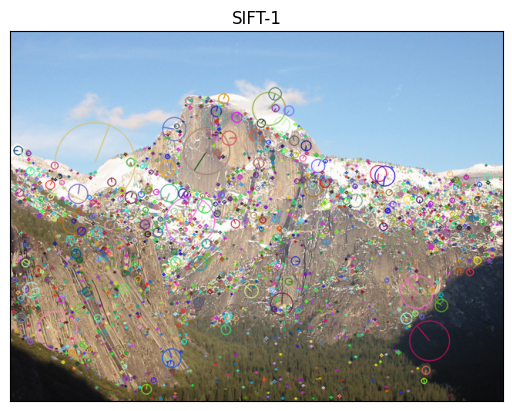

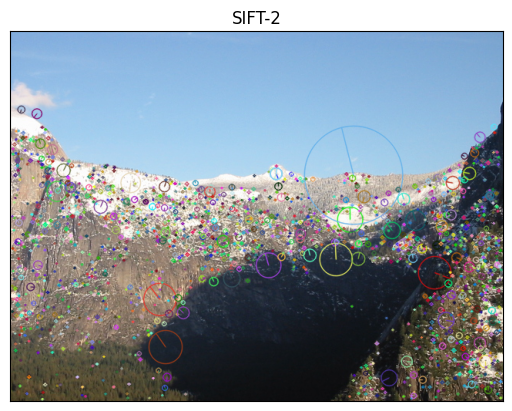

In [ ]:
# Load and prepare two images for feature matching
img1 = readIm(get_image('yosemite2.jpg'), 1)  # Read the first image in color
im1 = cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY)  # Convert the image from RGB to Grayscale for SIFT processing
img2 = readIm(get_image('yosemite3.jpg'), 1)  # Read the second image in color
im2 = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)  # Convert the second image to Grayscale

# Compute keypoints and descriptors using SIFT
# SIFT is used here because it provides robust, scale and rotation invariant features
kp1, desc1 = siftPoints(im1)  # Detect keypoints and compute descriptors for the first image
kp2, desc2 = siftPoints(im2)  # Do the same for the second image
# Display keypoints on the original color images
# This helps in visually verifying the distribution and quality of keypoints detected by SIFT
showKP(img1, kp1, "SIFT-1")  # Display keypoints for the first image
showKP(img2, kp2, "SIFT-2")  # Display keypoints for the second image

In this section, I apply previously developed functions to compute matches between descriptors using two different matching strategies: Brute-Force and KNN.

1. **Computing Matches**:
  - **Brute-Force Matching (`'BF'`)**: This method involves comparing each descriptor in the first image to every descriptor in the second image to find the closest match based on Euclidean distance. The cross-check ensures that only the best matches, where each pair is mutually the closest, are retained. This method is straightforward and robust for datasets where accuracy is more important than speed.
  - **K-Nearest Neighbors Matching (`'KNN'`)**: This method, often used in conjunction with the ratio test as described by David Lowe, involves finding the two nearest neighbors for each descriptor and selecting the match if the distance of the closest neighbor is significantly smaller than the second closest. This helps to remove many false matches prevalent in more ambiguous matching scenarios.

2. **Visualizing Matches**:
The `showMatches` function displays the matches between two images, limiting the visualization to the best 100 matches.
  - **Brute-Force matches** are very accurate.
  - **KNN matches** includes some mismatches.

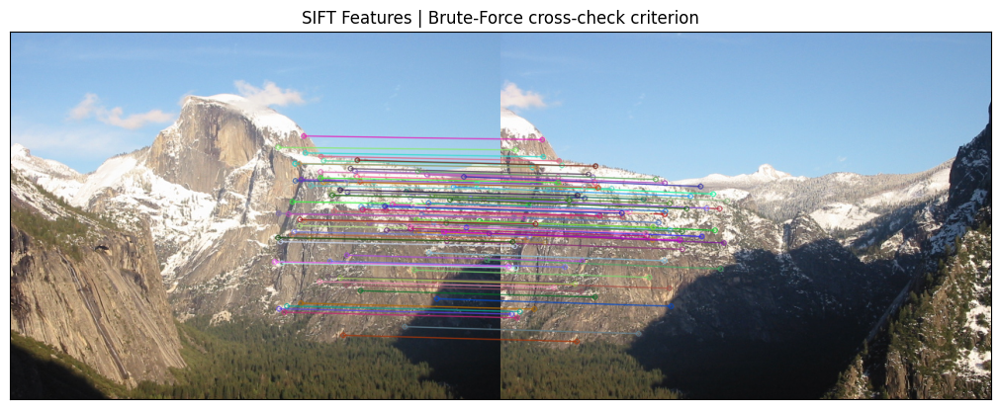

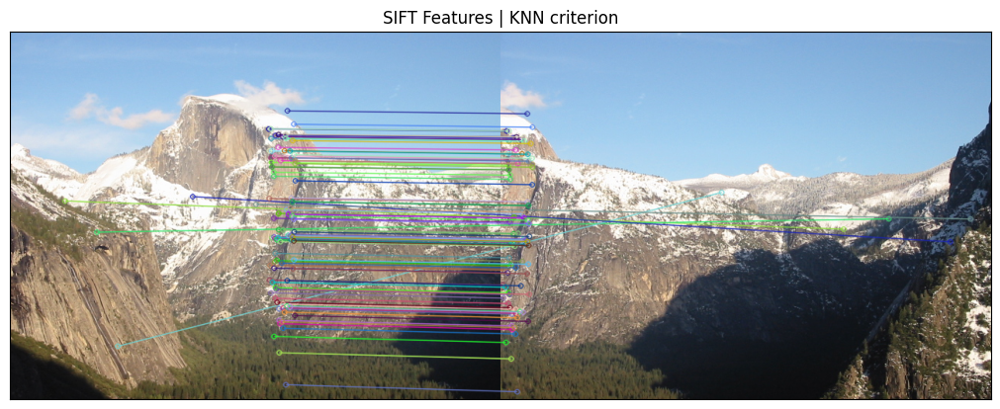

In [ ]:
# Compute matches between descriptors using two different matching strategies: Brute-Force and KNN
# Brute-Force Matcher with cross-check: Good for finding the best one-to-one matches
matches_BF = matching(desc1, desc2, 'BF')
# KNN Matcher with ratio test: Effective in filtering out weak matches
matches_KNN = matching(desc1, desc2, 'KNN')
# Show matches using Brute-Force matcher
# The function visualizes the first 100 matches based on their quality (distance)
# This is useful for evaluating the effectiveness of the matching process visually
showMatches(img1, kp1, img2, kp2, matches_BF, 100, title='SIFT Features | Brute-Force cross-check criterion')
# Show matches using KNN matcher
# Similarly, it displays the top 100 matches that pass the ratio test, indicating robust matches
showMatches(img1, kp1, img2, kp2, matches_KNN, 100, title='SIFT Features | KNN criterion')

Now, we have to perform exactly the same operation, but employing Haralick features. To do so, we are going to create a small window ($7\times7$ pixels) centered around the SIFT keypoint detected, and we are going to use `mahotas` library to compute those texture-based descriptors.

In [ ]:
!pip install mahotas

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 19.2 MB/s eta 0:00:00


In this section, I utilize the Haralick features method for keypoint descriptors and provide a detailed exploration into using texture-based features for image matching.

### **Step 1: SIFT for Keypoint Detection**

The `siftPoints` function is employed to detect keypoints in the image using the SIFT algorithm. This method ensures the keypoints are robust to changes in scale and rotation, providing a stable foundation for further descriptor computation.

### **Step 2: Haralick Descriptors for Texture Analysis**

Haralick features, computed in the `haralickDescriptors` function, are based on the gray-level co-occurrence matrix (GLCM) of image patches. These features capture texture information such as contrast, homogeneity, and energy, which can be particularly useful in natural scenes like landscapes where texture plays a significant role in the appearance.

### **Step 3: Matching Descriptors**

The `matchDescriptors` function compares Haralick descriptors using Euclidean distance to find the best match between descriptors from two images. This process focuses on minimizing the distance, indicating more similar texture patterns, which helps in identifying corresponding points across images.

### **Step 4: Visualization**

The `showMatches` function displays these matches, providing visual feedback on the effectiveness of texture-based matching.

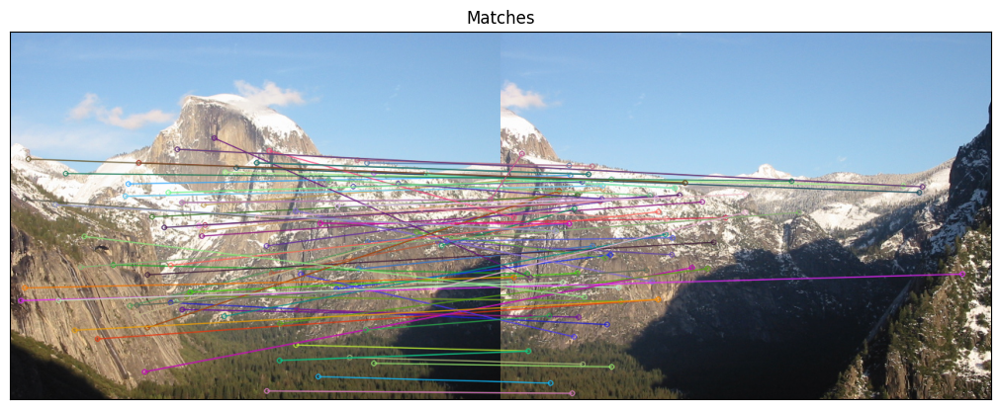

In [ ]:
import mahotas

'''
Function to compute keypoints and descriptors using SIFT
'''
def siftPoints(im, nfeatures=5000):
  sift = cv2.SIFT_create(nfeatures)  # Initialize SIFT descriptor
  kp, ds = sift.detectAndCompute(im, None)  # Detect keypoints and compute descriptors
  return kp, ds

'''
Function to compute Haralick descriptors at keypoints
'''
def haralickDescriptors(im, kp, size=13):
  half_size = size // 2  # Calculate half size for patch extraction
  descriptors = []
  for point in kp:
    x, y = int(point.pt[0]), int(point.pt[1])  # Get integer coordinates of the keypoint
    # Ensure the patch does not exceed image boundaries
    if x - half_size >= 0 and y - half_size >= 0 and x + half_size < im.shape[1] and y + half_size < im.shape[0]:
      # Extract a patch around the keypoint
      patch = im[y-half_size:y+half_size+1, x-half_size:x+half_size+1]
      # Compute Haralick features, averaging over four directions
      haralick = mahotas.features.haralick(patch).mean(0)
      descriptors.append(haralick)
    else:
      descriptors.append(None)  # Append None for keypoints too close to the edge
  return descriptors

'''
Function to match Haralick descriptors using Euclidean distance
'''
def matchDescriptors(ds1, ds2):
  matches = []
  for i, d1 in enumerate(ds1):
    if d1 is not None:
        min_dist = float('inf')
        best_j = -1
        for j, d2 in enumerate(ds2):
            if d2 is not None:
                dist = np.linalg.norm(d1 - d2)
                if dist < min_dist:
                    min_dist = dist
                    best_j = j
        if best_j != -1:
            matches.append(cv2.DMatch(_queryIdx=i, _trainIdx=best_j, _distance=min_dist))
  return sorted(matches, key=lambda x: x.distance)

# Load and preprocess images
img1 = readIm(get_image('yosemite2.jpg'), 1)
im1 = cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY)
img2 = readIm(get_image('yosemite3.jpg'), 1)
im2 = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)

# Compute keypoints and SIFT descriptors
kp1, desc1 = siftPoints(img1)
kp2, desc2 = siftPoints(img2)
# Compute Haralick descriptors at each keypoint
h_desc1 = haralickDescriptors(img1, kp1)
h_desc2 = haralickDescriptors(img2, kp2)
# Match Haralick descriptors between the two images
matches = matchDescriptors(h_desc1, h_desc2)
# Display matches between the two images
showMatches(img1, kp1, img2, kp2, matches, 100)  # Visualize the top 100 matches

Which feature descriptor seems to be more suitable for keypoint matching? Why?

In this particular instance, the SIFT descriptor significantly outperformed other methods, achieving nearly perfect detection, especially when using the Brute Force (BF) method. Conversely, the Haralick features method produced numerous false matches, rendering it unsuitable for keypoint matching.

# **Exercise 4:** Image Stitching using Homographies (3 points)

Now we are going to compute homographies between images, and use them to build a mosaic/panorama. To calculate the homography between two images, call the function `cv2.findHomography()`, which takes as input the lists of KeyPoints and the matches found between them. Use RANSAC to perform a robust estimation.

**Solution:**

In this section, I perform Image Stitching using Homographies.

### **Step 1: Compute the Homography**

1. **Purpose of Homography**:

A homography is a `3x3` transformation matrix that describes the transformation between two planes. In the context of image stitching, it is used to project the pixel coordinates of one image onto another, effectively aligning the two images based on the computed correspondence of `keypoints`.

2. **Matching Keypoint Extraction**:

The function starts by extracting the coordinates of the matched keypoints from both images. The `queryIdx` attribute refers to the index of the keypoint in the first image, while the `trainIdx` refers to the index in the second image. These indices are used to gather the corresponding points (`src_pts` for the source image and `dst_pts` for the destination image).

3. **Homography Calculation with RANSAC**:

The `cv2.findHomography` function is used to calculate the homography matrix `H` using the RANSAC method. RANSAC is particularly effective because it is robust to outliers, which are matches that do not fit the general pattern established by the other matches. The parameter `Ransac_Error` specifies the maximum allowed reprojection error to treat a point pair as an inlier. This makes the homography computation robust against noise and incorrect matches.

4. **Handling Insufficient Matches**:

The function checks if the number of matches exceeds a predefined threshold (`MIN_MATCH_COUNT`). If the condition is not met, the function prints an error message and returns `None`, indicating that the homography could not be computed due to insufficient data.

In [ ]:
# this function computes a homography
'''
Function to compute a homography matrix from matched keypoints
'''
def homography(kp1, kp2, matches, Ransac_Error, MIN_MATCH_COUNT=20):
  # Check if there are enough matches to compute a robust homography
  if len(matches) > MIN_MATCH_COUNT:
      # Extract the coordinates of the matched keypoints in the first image
      src_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
      # Extract the coordinates of the matched keypoints in the second image
      dst_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)
      # Compute the homography matrix using the RANSAC algorithm
      # RANSAC is used to estimate a robust homography that excludes outliers
      H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, Ransac_Error)
      return H
  else:
      # Error handling if not enough matches are found
      print('Error - very few matches')
  return None  # Return None if homography cannot be computed

To compose the mosaic we need to provide the following information:

> a) Maximum size of the canvas according to the number of images to be stitched and their dimensions.

> b) The central image that will give the axes to the mosaic.

> c) The order of each image with respect to the central one (i.e., we know the position of each image in the burst of images taken).

> d) The homography to copy the central image into the canvas.

Now, once all the aforementioned decisions have been made, we need to proceed as follows:
> a) Read the images from left to right.

> b) Set one central image as the reference to create the panorama. This one will provide the axes to the canvas.

> c) Compute the homography between each two consecutive images in your list.

> d) Set the canvas and the reference homography.

> e) Compute the homography between each image and the canvas.

> f) Use the computed homographies to transport the images to the canvas. Use the function `cv2. warpPerspective()`.

> g) Remove the black regions from the canvas to improve quality.



### **Step 2: Compose the Mosaic**

The mosaic composition involves determining the canvas size, choosing a central image for alignment, and ordering the images.


1. **Computing Local Homographies `computeLocalHomographies`**:

This function iterates through pairs of consecutive images to compute a homography matrix for each pair using SIFT for feature detection and matching. It employs the KNN method with Lowe's ratio test to ensure high-quality matches, which are then used to compute a robust homography via the RANSAC method, effectively filtering out outlier matches.

2. **Calculating Global Homographies `mosaicHomographies`**:

After computing local homographies between consecutive images, this function calculates the cumulative homographies for all images relative to a chosen central image. This approach involves both forward `rightward` and backward `leftward` propagation of transformations to align all images to the central reference frame, facilitating seamless image stitching.

3. **Adjusting Image Position `axesHomography`**:

Once all images are aligned through homographies, the `axesHomography` function is used to position the stitched panorama correctly within a larger canvas. It computes a simple translation matrix to center the stitched image, ensuring that the panorama is visually centered in the output canvas.


In [ ]:
# this function computes the homographies between each two consecutive images
'''
Function to compute homographies between each pair of consecutive images
'''
def computeLocalHomographies(images,method='KNN', Ransac_Error=5.0):
  sift = cv2.SIFT_create()  # Initialize SIFT descriptor
  homographies = []
  for i in range(len(images) - 1):
    # Detect keypoints and descriptors for each pair of images
    kp1, des1 = sift.detectAndCompute(images[i], None)
    kp2, des2 = sift.detectAndCompute(images[i + 1], None)
    # Initialize matcher based on the method choice
    if method == 'KNN':
        matcher = cv2.BFMatcher()
        matches = matcher.knnMatch(des1, des2, k=2)
        # Apply Lowe's ratio test to filter good matches
        good = [m for m, n in matches if m.distance < 0.75 * n.distance]
    else:
        matcher = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
        good = matcher.match(des1, des2)
        good = sorted(good, key=lambda x: x.distance)
    # Compute the homography using the filtered matches
    H = homography(kp1, kp2, good, Ransac_Error)
    homographies.append(H)
  return homographies

# this function computes the homography from each image to the canvas
# idx in this case is the central image
'''
Function to compute the global homography of each image relative to a central reference image
'''
def mosaicHomographies(H, idx):
  n = len(H) + 1  # Total number of images
  globalH = [None] * n
  globalH[idx] = np.eye(3)  # Identity matrix for the central image
  # Compute homographies to the right of the central image
  for i in range(idx + 1, n):
      globalH[i] = np.dot(globalH[i - 1], H[i - 1]) if globalH[i - 1] is not None else None
  # Compute homographies to the left of the central image
  for i in range(idx - 1, -1, -1):
      globalH[i] = np.dot(globalH[i + 1], np.linalg.inv(H[i])) if globalH[i + 1] is not None else None
  return globalH

# this function fixes the homography from the central image to the canvas
def axesHomography(sizeim,sizecanvas):
  H=np.eye(3)
  H[0,2]=sizecanvas[1]//2-sizeim[1]//2
  H[1,2]=sizecanvas[0]//2-sizeim[0]//2
  return H

4. **Canvas Initialization `setCanvas`**:

This function is crucial for setting up the workspace where the stitched images will be placed. The `row` and `col` parameters define the dimensions of the canvas, which should be large enough to accommodate the combined dimensions of the images being stitched. The `flagColor` parameter determines whether the canvas should support color images (3 channels) or grayscale images (1 channel).

5. **Redundant Pixel Removal `blackOut`**:

After placing and blending images on the canvas, there will likely be areas filled with black pixels with value zero, especially if the images don't completely fill the canvas or if there are discrepancies in the alignment. The `blackOut` function efficiently finds and removes these areas, creating a tighter bounding box around the actual content. It does so by converting the image to grayscale, creating a binary mask where non-black pixels are marked, and then calculating the bounding rectangle that encloses all non-black pixels. The image is then cropped to this rectangle, adjusted by an `offset` to control the tightness of the cropping.

In [ ]:
# Auxiliary functions

# This function defines and return the canvas
def setCanvas(row,col,flagColor,nim=2):
  # Create a canvas based on whether the image is color or grayscale
  # The canvas size is defined by the given number of rows and columns
  if flagColor:
    # If the images are in color, create a 3-channel canvas initialized to zeros
    return np.zeros((row, col, 3), np.uint8)
  else:
    # If the images are grayscale, create a single-channel canvas initialized to zeros
    return np.zeros((row, col), np.uint8)

# This function removes the redundant pixels from the canvas
def blackOut(img, offset=0):
  if len(img.shape)==3:
    im =cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    mask = np.array((im > 0), np.uint8)
    x,y,w,h=cv2.boundingRect(mask)
    return img[y+offset:y+h-offset,x+offset:x+w-offset,:]
  else:
    mask = np.array((img > 0), np.uint8)
    x,y,w,h=cv2.boundingRect(mask)
    return img[y+offset:y+h-offset,x+offset:x+w-offset]

6. **Mosaic Compose `composeMosaic`**

By implementing these steps, the `composeMosaic` function provides a comprehensive and flexible approach to image stitching, suitable for creating high-quality panoramas from a series of overlapping images.

  6.1. **Setting Up and Image Warping**:
  - The function iterates through all images specified, except for the central image which is added last. This is to ensure that the central image, often used as the primary reference frame, is not partially obscured by the stitching of other images.
  - For each non-central image, a homography matrix `H_final` is calculated by multiplying the global adjustment homography `H0` with the local homography `H[i]`. This matrix translates and transforms the current image to align it correctly on the canvas.
  - Each image is then warped using `cv2.warpPerspective`, which applies the homography to the image, effectively transforming it into the coordinate system of the canvas.

  6.2. **Masking and Image Placement**:

  A binary mask is created for the warped image to identify where valid pixel values exist. The canvas is then updated only in these valid areas, which helps in seamlessly blending images without overwriting useful data from previously placed images.

  6.3. **Central Image Handling**:

  After placing all other images, the central image is processed. Its homography (`H_central`) is calculated in the same manner as the others, and it's placed last to ensure it appears prominently in the mosaic, using the same warping and masking technique.

  6.4. **Cleaning Up the Final Output**:

  After all images are warped and placed, the `blackOut` function is called to crop out any remaining black borders, ensuring the final mosaic is tightly bounded by image content.

  6.5. **Visualization**:

  The final mosaic is displayed using a `displayIm` function.

In [ ]:
# this function composes the mosaic
def composeMosaic(images,canvas,H,idxc,H0):
  rows=canvas.shape[0] # Get the number of rows in the canvas
  cols=canvas.shape[1] # Get the number of columns in the canvas

  # Iterate through all images except the central one to apply homographies and compose them onto the canvas
  for i, image in enumerate(images):
    if i != idxc:  # Skip the central image for now, it will be added last
      # Calculate the final homography matrix for the current image to the canvas coordinate system
      H_final = np.dot(H0, H[i])
      # Warp the image using the final homography matrix
      warped_image = cv2.warpPerspective(image, H_final, (cols, rows))
      # Create a mask where the warped image has valid (non-zero) pixels
      mask = (warped_image > 0)
      # Place the warped image onto the canvas, only where the mask is True
      canvas[mask] = warped_image[mask]
  # Process the central image last to ensure it overlays correctly without being overwritten
  central_image = images[idxc]
  H_central = np.dot(H0, H[idxc])
  central_warped = cv2.warpPerspective(central_image, H_central, (cols, rows))
  central_mask = (central_warped > 0)
  canvas[central_mask] = central_warped[central_mask]
  # Remove the black space around the composed mosaic
  blackOut(canvas) # BlackOut function cleans up the image
  displayIm(canvas, '', 2)  # Display the final mosaic
  return canvas

In this section, I descrive steps performed for constructing a mosaic from a sequence of images, specifically handling a left-to-right camera motion.

1. **Image Loading**:
   - Images are loaded using a specified prefix and list of filenames. The `readIm` function, which is assumed to handle the image loading, is called with the `flagColor=1` argument to ensure images are loaded in color.

2. **Local Homography Computation**:
   - Local homographies between each pair of consecutive images are computed using the `computeLocalHomographies` function, which utilizes the SIFT feature detector and the KNN matching method along with RANSAC for robust outlier rejection.

3. **Global Homography Calculation**:
   - The `mosaicHomographies` function calculates global homographies that align each image to a central reference frame, chosen to be the middle image in the sequence. This is crucial for ensuring that all images can be seamlessly stitched.

4. **Canvas Setup**:
   - A canvas large enough to hold the stitched images is initialized using `setCanvas`. The size is determined based on the dimensions of the central image, scaled to ensure there is enough space to accommodate all images after transformation.

5. **Adjusting the Central Image Homography**:
   - The `axesHomography` function is used to adjust the homography of the central image, ensuring it is centered on the canvas. This step is important for proper alignment within the larger composite image.

6. **Mosaic Composition and Display**:
   - Finally, the `composeMosaic` function is called to transform and stitch all images onto the canvas according to their computed homographies. The result is then displayed, showing the complete panoramic image created from the individual photos.


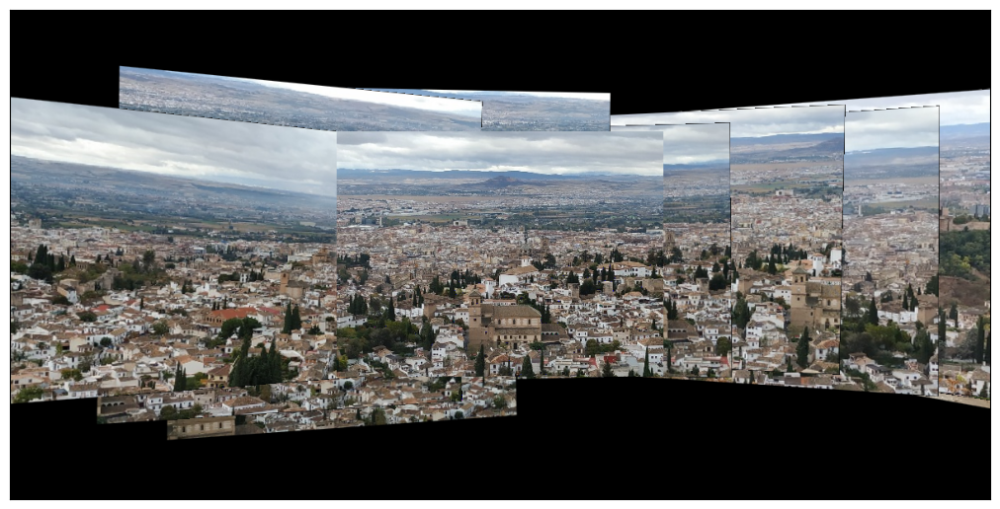

In [ ]:
images=[]
#Mosaic construction: Left-Right camera motion

PREFIX='IMG_20211030_1104'
DIR=''
nameImages=['10_S.jpg','13_S.jpg','15_S.jpg','17_S.jpg','18_S.jpg','20_S.jpg',
            '21_S.jpg', '25_S.jpg','26_S.jpg', '28_S.jpg','31_S.jpg','33_S.jpg',
            '34_S.jpg','36_S.jpg']

for item in nameImages:
  images.append(readIm(get_image(PREFIX+item),flagColor=1))

# Compute local homographies between consecutive images
H = computeLocalHomographies(images, method='KNN', Ransac_Error=5.0)
# Assuming the central image is roughly in the middle of the dataset
idx_central = len(images) // 2
globalH = mosaicHomographies(H, idx_central)
# Define the size of the canvas based on the dimensions of the central image
# Assuming images are of the same size, using the first image for dimensions
height, width = images[0].shape[:2]
canvas = setCanvas(height*2, width*3, flagColor=1)  # Scaled size for canvas
# Fixing the homography from the central image to the canvas
H0 = axesHomography(images[idx_central].shape, canvas.shape)
# Compose and display the mosaic
mosaic = composeMosaic(images, canvas, globalH, idx_central, H0)

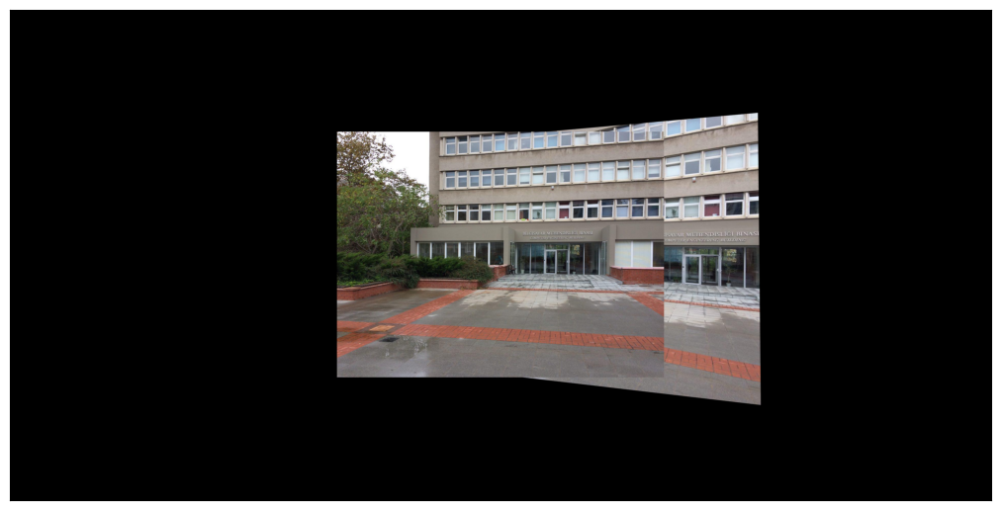

In [ ]:
# Load the two images
img2 = readIm('photo1.jpg', flagColor=1)
img1 = readIm('photo2.jpg', flagColor=1)

images=[img1, img2]

# Compute the homography between the two images
H = computeLocalHomographies(images, method='KNN', Ransac_Error=5.0)

# Assuming the central image is roughly in the middle of the dataset
idx_central = len(images) // 2
globalH = mosaicHomographies(H, idx_central)
# Define the size of the canvas based on the dimensions of the central image
# Assuming images are of the same size, using the first image for dimensions
height, width = images[0].shape[:2]
canvas = setCanvas(height*2, width*3, flagColor=1)  # Scaled size for canvas
# Fixing the homography from the central image to the canvas
H0 = axesHomography(images[idx_central].shape, canvas.shape)
# Compose and display the mosaic
mosaic = composeMosaic(images, canvas, globalH, idx_central, H0)

In [ ]:
'''
Compute homography between two images using keypoint matches.

This function computes the homography matrix between two images based on the keypoints matches.

Parameters:
- kp1 (list of cv2.KeyPoint objects): Keypoints detected in the first image.
- kp2 (list of cv2.KeyPoint objects): Keypoints detected in the second image.
- matches (list of cv2.DMatch objects): Matches between keypoints of the two images.
- Ransac_Error (float): RANSAC reprojection error threshold.
- MIN_MATCH_COUNT (int): Minimum number of matches required for computing homography. (default: 20)

Returns:
- ndarray: Homography matrix if enough matches are found, otherwise None.
'''
def homography(kp1, kp2, matches, Ransac_Error, MIN_MATCH_COUNT=20):
    # Check if enough matches are available for computing homography
    if len(matches) > MIN_MATCH_COUNT:
        # Extract source and destination points from the matches
        src_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
        dst_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)
        # Compute homography using RANSAC algorithm
        H, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, Ransac_Error)
    else:
        print('Error - very few matches')
        H = None
    return H

'''
Compute homographies between each two consecutive images.

This function computes the homographies between each two consecutive images in the list of images.

Parameters:
- images (list of ndarray): List of images.
- method (str): Method to use for matching descriptors. Options: 'KNN' for K-nearest neighbors, 'BF' for brute force. Default is 'KNN'.
- Ransac_Error (float): RANSAC error threshold for homography estimation. Default is 5.0.

Returns:
- list of ndarray: List of computed homographies.
'''
def computeLocalHomographies(images, method='KNN', Ransac_Error=5.0):
    # Initialize list to store homographies
    H = []

    # Iterate through each pair of consecutive images
    for i in range(len(images)-1):
        # Detect keypoints and compute descriptors for the first image
        kp1, ds1 = siftPoints(images[i])
        # Detect keypoints and compute descriptors for the second image
        kp2, ds2 = siftPoints(images[i+1])
        # Match descriptors between the two images
        matches = matching(ds1, ds2, method)
        # Compute homography between the keypoints
        h = homography(kp1, kp2, matches, Ransac_Error)
        # Append the computed homography to the list
        H.append(h)

    # Return the list of homographies
    return H

'''
Compute homographies from each image to the canvas.

This function computes the homographies from each image to the canvas.

Parameters:
- H (list of ndarray): List of local homographies between consecutive images.
- idx (int): Index of the central image.

Returns:
- list of ndarray: List of global homographies from each image to the canvas.
'''
def mosaicHomographies(H, idx):
    # Calculate the number of homographies
    n = len(H) + 1
    # Initialize a list to store global homographies
    globalH = [None]*(n)
    # Set the homography of the central image to the identity matrix
    globalH[idx] = np.eye(3)

    # Compute homographies for images before the central image
    for i in range(idx - 1, -1, -1):
        globalH[i] = np.dot(globalH[i + 1], H[i])

    # Compute homographies for images after the central image
    for i in range(idx + 1, n):
        globalH[i] = np.dot(globalH[i - 1], np.linalg.inv(H[i - 1]))

    # Return the list of global homographies
    return globalH

'''
Fix the homography from the central image to the canvas.

This function fixes the homography from the central image to the canvas.

Parameters:
- sizeim (tuple): Size of the central image (height, width).
- sizecanvas (tuple): Size of the canvas (height, width).

Returns:
- ndarray: Homography matrix.
'''
def axesHomography(sizeim, sizecanvas):
    # Initialize a 3x3 identity matrix for the homography
    H = np.eye(3)
    # Set the translation parameters to position the central image on the canvas
    H[0, 2] = sizecanvas[1] // 2 - sizeim[1] // 2
    H[1, 2] = sizecanvas[0] // 2 - sizeim[0] // 2
    # Return the homography
    return H

# Auxiliary functions
'''
Define and return the canvas for creating the mosaic.

This function creates and returns an empty canvas with specified dimensions and color mode.

Parameters:
- row (int): Number of rows in the canvas.
- col (int): Number of columns in the canvas.
- flagColor (bool): Flag indicating whether the canvas should be color (True) or grayscale (False).
- nim (int): Number of images to be stitched. Default is 2.

Returns:
- ndarray: Empty canvas with specified dimensions and color mode.
'''
def setCanvas(row, col, flagColor, nim=2):
    # Check if the canvas should be in color or grayscale
    if flagColor:
        # Create a black canvas with color channels if flagColor is True
        canvas = np.zeros((row, col, 3), dtype=np.uint8)
    else:
        # Create a black canvas without color channels if flagColor is False
        canvas = np.zeros((row, col), dtype=np.uint8)
    # Return the created canvas
    return canvas

'''
Remove redundant pixels from the image.

This function removes redundant pixels from the image by finding the bounding rectangle of non-zero pixels.

Parameters:
- img (ndarray): Input image.
- offset (int): Offset value to adjust the bounding rectangle. Default is 0.

Returns:
- ndarray: Cropped image without redundant pixels.
'''
def blackOut(img, offset=0):
    # Check if the input image is in color or grayscale
    if len(img.shape) == 3:
        # Convert the image to grayscale
        im = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        # Create a binary mask where non-black pixels are set to 1
        mask = np.array((im > 0), np.uint8)
        # Compute the bounding rectangle of the non-black pixels
        x, y, w, h = cv2.boundingRect(mask)
        # Return the cropped image with an optional offset
        return img[y + offset:y + h - offset, x + offset:x + w - offset, :]
    else:
        # Create a binary mask where non-black pixels are set to 1
        mask = np.array((img > 0), np.uint8)
        # Compute the bounding rectangle of the non-black pixels
        x, y, w, h = cv2.boundingRect(mask)
        # Return the cropped image with an optional offset
        return img[y + offset:y + h - offset, x + offset:x + w - offset]

'''
Compose the mosaic by stitching multiple images onto a canvas using the provided homographies.

Parameters:
- images (list): List of input images to be stitched.
- canvas (ndarray): Canvas to compose the mosaic on.
- H (list): List of homographies computed between consecutive images.
- idxc (int): Index of the central image used as a reference for the mosaic.
- H0 (ndarray): Homography from each image to the canvas.

Returns:
- ndarray: Composed mosaic image.
'''

# Compose the mosaic by stitching images onto the canvas
def composeMosaic(images, canvas, H, idxc, H0):
    # Get the dimensions of the canvas
    rows = canvas.shape[0]
    cols = canvas.shape[1]

    # Iterate over each image in the list
    for i, image in enumerate(images):
        # Compute the final homography by combining the initial homography and the homography of the current image
        final_H = np.matmul(H0, H[i])

        # Warp the current image using the final homography to align it with the canvas
        warped_image = cv2.warpPerspective(image, final_H, (cols, rows))

        # Create a mask to identify non-black pixels in the warped image
        mask = warped_image > 0

        # Update the canvas with the warped image, preserving non-black pixels
        canvas[mask] = warped_image[mask]

    # Return the composed mosaic image
    return canvas

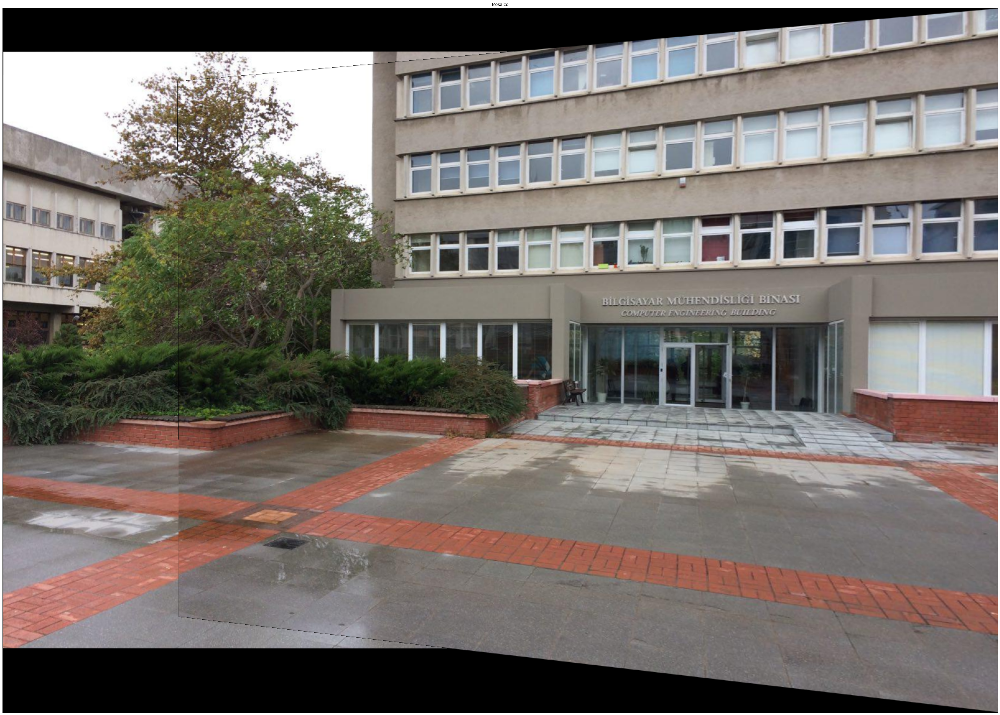

In [ ]:
'''
Now, Construct a mosaic by stitching images captured with left-to-right camera motion.

Variables:
- PREFIX (str): Prefix for image filenames.
- nameImages (list): List of image filenames.
- DIR (str): Directory containing the images.
- rows (int): Height of the canvas for the mosaic.
- cols (int): Accumulated width of all images for the mosaic.
- images (list): List of input images for stitching.
- H (list): List of computed homographies between consecutive images.
- H0 (ndarray): Homography from each image to the canvas.
- canvas (ndarray): Canvas to compose the mosaic on.
- mosaic (ndarray): Composed mosaic image.

'''

# Load the two images
img2 = readIm('photo1.jpg', flagColor=1)
img1 = readIm('photo2.jpg', flagColor=1)

images=[img1, img2]

# Accumulated width of all images for the mosaic
cols = 0

# Read images and accumulate their width
for i in range(2):
    # Read image and append it to the list
    img = images[i]
    images.append(img)

    # Update accumulated width
    cols += img.shape[0]

# Compute the height of the canvas for the mosaic
rows = images[0].shape[1] + 1000

# Compute local homographies between consecutive images
H = computeLocalHomographies(images)

# Compute global homographies for the entire mosaic
central_index = 0 # Choosing the central image manually
H = mosaicHomographies(H, central_index)

# Create the canvas for the mosaic
canvas = setCanvas(rows, cols, True)

# Get the dimensions of the central image and the canvas
sizeim = images[central_index].shape
sizecanvas = canvas.shape

# Compute the homography from the central image to the canvas
H0 = axesHomography(sizeim, sizecanvas)

# Compose the mosaic by stitching images onto the canvas
mosaic = composeMosaic(images, canvas, H, 4, H0)

# Display the composed mosaic image with excess black space removed
displayIm(blackOut(mosaic), 'Mosaico', 8)

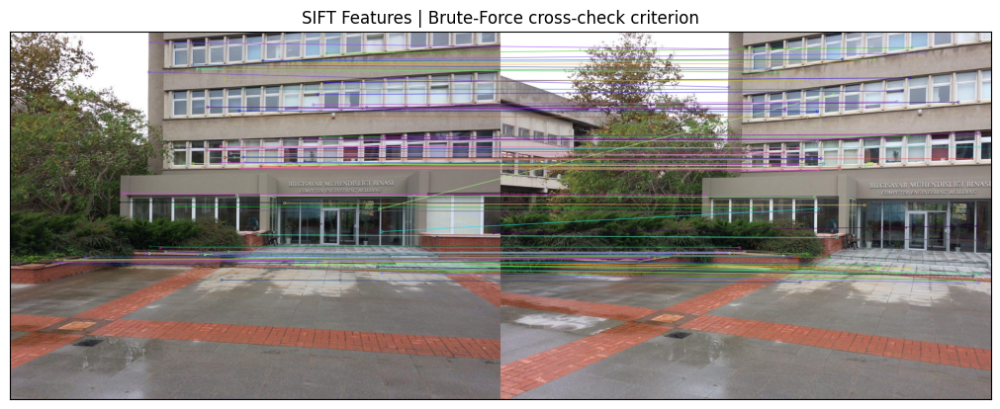

In [ ]:
'''
SIFT Key points
'''

# Load and prepare two images for feature matching
# Load the two images
img1 = readIm('photo1.jpg', flagColor=1)
img2 = readIm('photo2.jpg', flagColor=1)
im1 = cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY)  # Convert the image from RGB to Grayscale for SIFT processing
im2 = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)  # Convert the second image to Grayscale

# Compute keypoints and descriptors using SIFT
# SIFT is used here because it provides robust, scale and rotation invariant features
kp1, desc1 = siftPoints(im1)  # Detect keypoints and compute descriptors for the first image
kp2, desc2 = siftPoints(im2)  # Do the same for the second image

# Compute matches between descriptors using two different matching strategies: Brute-Force and KNN
# Brute-Force Matcher with cross-check: Good for finding the best one-to-one matches
matches_BF = matching(desc1, desc2, 'BF')
# KNN Matcher with ratio test: Effective in filtering out weak matches
matches_KNN = matching(desc1, desc2, 'KNN')
# Show matches using Brute-Force matcher
# The function visualizes the first 100 matches based on their quality (distance)
# This is useful for evaluating the effectiveness of the matching process visually
showMatches(img1, kp1, img2, kp2, matches_BF, 100, title='SIFT Features | Brute-Force cross-check criterion')

In [ ]:
def calculate_displacements(kp1, kp2, matches):
    displacements = []
    for match in matches:
        # Get the position of matched keypoints
        x1, y1 = kp1[match.queryIdx].pt
        x2, y2 = kp2[match.trainIdx].pt
        displacement = (x2 - x1, y2 - y1)
        displacements.append(displacement)
    return displacements

In [ ]:
# Calculate displacements
displacements_BF = calculate_displacements(kp1, kp2, matches_BF)

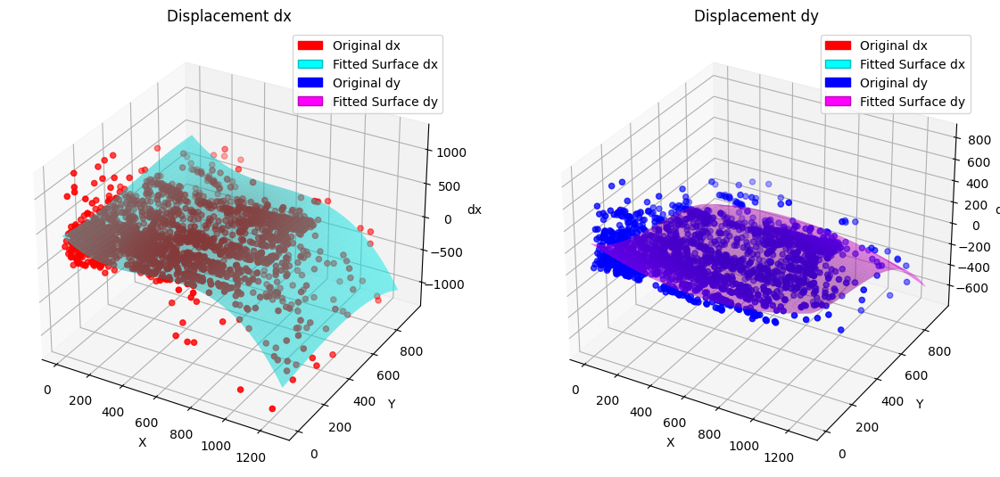

In [ ]:
import numpy as np
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
import matplotlib.pyplot as plt
from matplotlib.patches import Patch  # To create custom legend entries

class Poly3x3Model:
    def __init__(self):
        self.poly = PolynomialFeatures(degree=3)
        self.model_dx = LinearRegression()
        self.model_dy = LinearRegression()

    def fit(self, X, Y, dx, dy):
        features = self.poly.fit_transform(np.column_stack((X, Y)))
        self.model_dx.fit(features, dx)
        self.model_dy.fit(features, dy)

    def predict(self, X, Y):
        features = self.poly.transform(np.column_stack((X, Y)))
        predicted_dx = self.model_dx.predict(features)
        predicted_dy = self.model_dy.predict(features)
        return predicted_dx, predicted_dy

    def plot(self, X, Y, dx, dy):
        fig, (ax1, ax2) = plt.subplots(1, 2, subplot_kw={'projection': '3d'}, figsize=(14, 7))

        # Meshgrid for surface plotting
        grid_x, grid_y = np.mgrid[X.min():X.max():50j, Y.min():Y.max():50j]
        grid_dx, grid_dy = self.predict(grid_x.ravel(), grid_y.ravel())
        grid_dx = grid_dx.reshape(grid_x.shape)
        grid_dy = grid_dy.reshape(grid_x.shape)

        # Plotting displacement dx
        ax1.scatter(X, Y, dx, color='red', label='Original dx')
        surf1 = ax1.plot_surface(grid_x, grid_y, grid_dx, color='cyan', alpha=0.5)
        ax1.set_title('Displacement dx')
        ax1.set_xlabel('X')
        ax1.set_ylabel('Y')
        ax1.set_zlabel('dx')

        # Plotting displacement dy
        ax2.scatter(X, Y, dy, color='blue', label='Original dy')
        surf2 = ax2.plot_surface(grid_x, grid_y, grid_dy, color='magenta', alpha=0.5)
        ax2.set_title('Displacement dy')
        ax2.set_xlabel('X')
        ax2.set_ylabel('Y')
        ax2.set_zlabel('dy')

        # Create custom legend entries
        legend_elements = [Patch(facecolor='red', edgecolor='r', label='Original dx'),
                           Patch(facecolor='cyan', edgecolor='c', label='Fitted Surface dx'),
                           Patch(facecolor='blue', edgecolor='b', label='Original dy'),
                           Patch(facecolor='magenta', edgecolor='m', label='Fitted Surface dy')]

        # Add legends
        ax1.legend(handles=legend_elements, loc='upper right')
        ax2.legend(handles=legend_elements, loc='upper right')

        plt.show()

# Extract X, Y coordinates and displacements
X = np.array([kp1[m.queryIdx].pt[0] for m in matches_BF])  # X coordinates from the first image
Y = np.array([kp1[m.queryIdx].pt[1] for m in matches_BF])  # Y coordinates from the first image
dx = np.array([disp[0] for disp in displacements_BF])      # Displacement in X
dy = np.array([disp[1] for disp in displacements_BF])      # Displacement in Y

model = Poly3x3Model()
model.fit(X, Y, dx, dy)
predicted_dx, predicted_dy = model.predict(X, Y)
model.plot(X, Y, dx, dy)

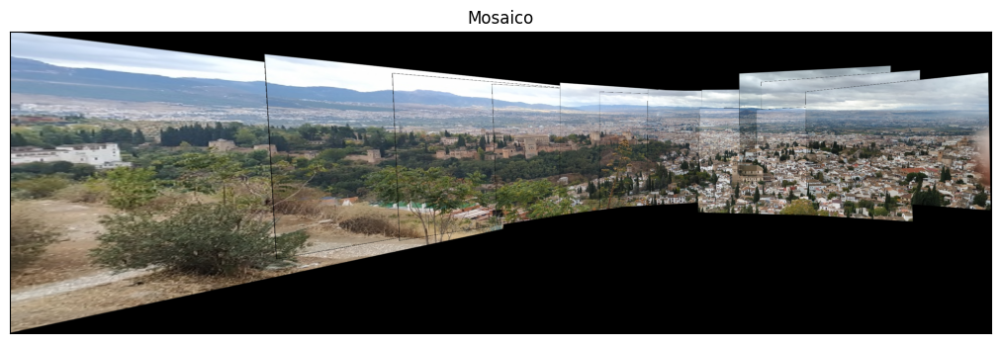

In [ ]:
'''
Now, Construct a mosaic by stitching images captured with left-to-right camera motion.

Variables:
- PREFIX (str): Prefix for image filenames.
- nameImages (list): List of image filenames.
- DIR (str): Directory containing the images.
- rows (int): Height of the canvas for the mosaic.
- cols (int): Accumulated width of all images for the mosaic.
- images (list): List of input images for stitching.
- H (list): List of computed homographies between consecutive images.
- H0 (ndarray): Homography from each image to the canvas.
- canvas (ndarray): Canvas to compose the mosaic on.
- mosaic (ndarray): Composed mosaic image.

'''

# Initialize list to store images
images = []

# Define prefix for image filenames
PREFIX = 'IMG_20211030_1104'

# Define directory containing the images
DIR = ''

# List of image filenames
nameImages = ['10_S.jpg', '13_S.jpg', '15_S.jpg', '17_S.jpg', '18_S.jpg', '20_S.jpg',
              '21_S.jpg', '25_S.jpg', '26_S.jpg', '28_S.jpg', '31_S.jpg', '33_S.jpg',
              '34_S.jpg', '36_S.jpg']

# Accumulated width of all images for the mosaic
cols = 0

# Read images and accumulate their width
for item in nameImages:
    # Read image and append it to the list
    img = readIm(get_image(PREFIX + item), flagColor=1)
    images.append(img)

    # Update accumulated width
    cols += img.shape[0]

# Compute the height of the canvas for the mosaic
rows = images[0].shape[1] + 1000

# Compute local homographies between consecutive images
H = computeLocalHomographies(images)

# Compute global homographies for the entire mosaic
central_index = 7 # Choosing the central image manually
H = mosaicHomographies(H, central_index)

# Create the canvas for the mosaic
canvas = setCanvas(rows, cols, True)

# Get the dimensions of the central image and the canvas
sizeim = images[4].shape
sizecanvas = canvas.shape

# Compute the homography from the central image to the canvas
H0 = axesHomography(sizeim, sizecanvas)

# Compose the mosaic by stitching images onto the canvas
mosaic = composeMosaic(images, canvas, H, 4, H0)

# Display the composed mosaic image with excess black space removed
displayIm(blackOut(mosaic), 'Mosaico')